In [3]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/test11/105859_1_01vid-deepfake-disinfo-summit_wg_1080p.mp4
/kaggle/input/testingimgexrtdf/images (2).jpg
/kaggle/input/testingimgexrtdf/105859_1_01vid-deepfake-disinfo-summit_wg_1080p - frame at 0m5s.jpg
/kaggle/input/testingimgexrtdf/DSC_0127.jpg
/kaggle/input/testingimgexrtdf/bfeewgzrbr.jpg
/kaggle/input/testingimgexrtdf/images (1).jpg
/kaggle/input/testingimgexrtdf/images.jpg


KeyboardInterrupt: 

In [ ]:
import cv2
import keras
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Create training dataset
train_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.4,
    image_size=(224, 224),
    batch_size=32
)

# Create validation dataset
val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/valid",
    validation_split=0.2,
    image_size=(224, 224),
    batch_size=32
)

# Create testing dataset
test_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/test",
    validation_split=0.2,
    image_size=(224, 224),
    batch_size=32
)


train_image_count = count_images(train_val_dataset)
val_image_count = count_images(val_dataset)
test_image_count = count_images(test_dataset)

print(f"Number of training images: {train_image_count}")
print(f"Number of validation images: {val_image_count}")
print(f"Number of testing images: {test_image_count}")



# Define VGG16 model
model = keras.Sequential()

# Block 1
model.add(Conv2D(64, kernel_size=(3, 3), padding='same', activation="relu", input_shape=(224, 224, 3)))
model.add(Conv2D(64, kernel_size=(3, 3), padding='same', activation="relu"))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 2
model.add(Conv2D(128, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(128, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 3
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 4
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 5
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Top layers
model.add(Flatten())
model.add(Dense(4096, activation="relu"))
model.add(Dense(4096, activation ="relu"))
model.add(Dense(2, activation="softmax"))

model.build()
model.summary()

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=10)

# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Evaluate the model on the test dataset
test_loss, test_acc = model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc}")


In [ ]:
import cv2
import keras
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Create training dataset
train_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.4,
    subset="training",
    seed=123,
    image_size=(224, 224),
    batch_size=32
)

# Create validation dataset
val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.2,
    subset="validation",
    seed=123,
    image_size=(224, 224),
    batch_size=32
)

# Create testing dataset
test_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/test",
    image_size=(224, 224),
    batch_size=32
)

def count_images(dataset):
    return sum([len(batch) for batch, _ in dataset])

train_image_count = count_images(train_dataset)
val_image_count = count_images(val_dataset)
test_image_count = count_images(test_dataset)

print(f"Number of training images: {train_image_count}")
print(f"Number of validation images: {val_image_count}")
print(f"Number of testing images: {test_image_count}")

# Define VGG16 model
model = keras.Sequential()

# Block 1
model.add(Conv2D(64, kernel_size=(3, 3), padding='same', activation="relu", input_shape=(224, 224, 3)))
model.add(Conv2D(64, kernel_size=(3, 3), padding='same', activation="relu"))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 2
model.add(Conv2D(128, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(128, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 3
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 4
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 5
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Top layers
model.add(Flatten())
model.add(Dense(4096, activation="relu"))
model.add(Dense(4096, activation ="relu"))
model.add(Dense(2, activation="softmax"))

model.build()
model.summary()

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=10)

# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Evaluate the model on the test dataset
test_loss, test_acc = model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc}")


In [ ]:
import os
import cv2
import keras
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
# dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Create training dataset
train_dataset = image_dataset_from_directory(
    # directory=f"{dataset_dir}/train",
    directory=f"{dataset_dir}/train",
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(224, 224),
    batch_size=32
)

# Create validation dataset
val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/valid",
    validation_split=0.1,
    subset="validation",
    seed=123,
    image_size=(224, 224),
    batch_size=32
)

# Create testing dataset
# test_dataset = image_dataset_from_directory(
#     directory=f"{dataset_dir}/testing",
#     image_size=(224, 224),
#     batch_size=32
# )

def count_images(dataset):
    return sum([len(batch) for batch, _ in dataset])

def count_real_and_fake_images(directory):
    real_count = 0
    fake_count = 0
    for label in ['real', 'fake']:
        path = os.path.join(directory, label)
        for root, _, files in os.walk(path):
            if label == 'real':
                real_count += len(files)
            elif label == 'fake':
                fake_count += len(files)
    return real_count, fake_count

train_image_count = count_images(train_dataset)
val_image_count = count_images(val_dataset)
# test_image_count = count_images(test_dataset)

# train_real_count, train_fake_count = count_real_and_fake_images(f"{dataset_dir}/train")
val_real_count = int(train_real_count * 0.4)
val_fake_count = int(train_fake_count * 0.4)
train_real_count -= val_real_count
train_fake_count -= val_fake_count

# test_real_count, test_fake_count = count_real_and_fake_images(f"{dataset_dir}/test")

print(f"Number of training images: {train_image_count} (Real: {train_real_count}, Fake: {train_fake_count})")
print(f"Number of validation images: {val_image_count} (Real: {val_real_count}, Fake: {val_fake_count})")
# print(f"Number of testing images: {test_image_count} (Real: {test_real_count}, Fake: {test_fake_count})")

# Define VGG16 model
model = keras.Sequential()

# Block 1
model.add(Conv2D(64, kernel_size=(3, 3), padding='same', activation="relu", input_shape=(224, 224, 3)))
model.add(Conv2D(64, kernel_size=(3, 3), padding='same', activation="relu"))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 2
model.add(Conv2D(128, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(128, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 3
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(256, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 4
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Block 5
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(Conv2D(512, kernel_size=(3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# Top layers
model.add(Flatten())
model.add(Dense(4096, activation="relu"))
model.add(Dense(4096, activation ="relu"))
model.add(Dense(2, activation="softmax"))

model.build()
model.summary()

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=1)

# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Evaluate the model on the test dataset
test_loss, test_acc = model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc}")


In [ ]:
import os
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing import image_dataset_from_directory
import matplotlib.pyplot as plt

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Helper function to count images
def count_images(dataset):
    real_count = 0
    fake_count = 0
    for images, labels in dataset:
        real_count += (labels == 0).numpy().sum()
        fake_count += (labels == 1).numpy().sum()
    return real_count, fake_count

# Create training and validation datasets
train_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(224, 224),
    batch_size=32
)

val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/valid",
    validation_split=0.1,
    subset="validation",
    seed=123,
    image_size=(224, 224),
    batch_size=32
)

# Create testing dataset
# test_dataset = image_dataset_from_directory(
#     directory=f"{dataset_dir}/test",
#     image_size=(224, 224),
#     batch_size=32
# )

# Count images in each dataset
train_real_count, train_fake_count = count_images(train_dataset)
val_real_count, val_fake_count = count_images(val_dataset)
# test_real_count, test_fake_count = count_images(test_dataset)

print(f"Number of training images: {train_real_count + train_fake_count} (Real: {train_real_count}, Fake: {train_fake_count})")
print(f"Number of validation images: {val_real_count + val_fake_count} (Real: {val_real_count}, Fake: {val_fake_count})")
# print(f"Number of testing images: {test_real_count + test_fake_count} (Real: {test_real_count}, Fake: {test_fake_count})")

# Define VGG16-like model
model = models.Sequential()

# Block 1
model.add(layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(224, 224, 3)))
model.add(layers.Conv2D(64, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 2
model.add(layers.Conv2D(128, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(128, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 3
model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 4
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 5
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Top layers
model.add(layers.Flatten())
model.add(layers.Dense(4096, activation='relu'))
model.add(layers.Dense(4096, activation='relu'))
model.add(layers.Dense(2, activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=10)

# Plotting training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Evaluate the model on the test dataset
# test_loss, test_acc = model.evaluate(test_dataset)
# print(f"Test accuracy: {test_acc}")



In [ ]:
# Create testing dataset
test_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/test",
    image_size=(224, 224),
    batch_size=32
)

test_real_count, test_fake_count = count_images(test_dataset)
print(f"Number of testing images: {test_real_count + test_fake_count} (Real: {test_real_count}, Fake: {test_fake_count})")


# Evaluate the model on the test dataset
test_loss, test_acc = model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc}")

In [ ]:
import os
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing import image_dataset_from_directory
import matplotlib.pyplot as plt

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Helper function to count images
def count_images(dataset):
    real_count = 0
    fake_count = 0
    for images, labels in dataset:
        real_count += (labels == 0).numpy().sum()
        fake_count += (labels == 1).numpy().sum()
    return real_count, fake_count

# Create training and validation datasets
train_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.5,
    subset="training",
    seed=123,
    image_size=(224, 224),
    batch_size=15
)

val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/valid",
    validation_split=0.5,
    subset="validation",
    seed=123,
    image_size=(224, 224),
    batch_size=15
)

# Create testing dataset
# test_dataset = image_dataset_from_directory(
#     directory=f"{dataset_dir}/test",
#     image_size=(224, 224),
#     batch_size=32
# )

# Count images in each dataset
train_real_count, train_fake_count = count_images(train_dataset)
val_real_count, val_fake_count = count_images(val_dataset)
# test_real_count, test_fake_count = count_images(test_dataset)

print(f"Number of training images: {train_real_count + train_fake_count} (Real: {train_real_count}, Fake: {train_fake_count})")
print(f"Number of validation images: {val_real_count + val_fake_count} (Real: {val_real_count}, Fake: {val_fake_count})")
# print(f"Number of testing images: {test_real_count + test_fake_count} (Real: {test_real_count}, Fake: {test_fake_count})")

# Define VGG16-like model
model = models.Sequential()

# Block 1
model.add(layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(224, 224, 3)))
model.add(layers.Conv2D(64, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 2
model.add(layers.Conv2D(128, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(128, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 3
model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 4
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Block 5
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.Conv2D(512, (3, 3), padding='same', activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))

# Top layers
model.add(layers.Flatten())
model.add(layers.Dense(4096, activation='relu'))
model.add(layers.Dense(4096, activation='relu'))
model.add(layers.Dense(2, activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=10)

# Plotting training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Evaluate the model on the test dataset
# test_loss, test_acc = model.evaluate(test_dataset)
# print(f"Test accuracy: {test_acc}")



In [ ]:
import os
import shutil
import random

def split_data(source_dir, dest_dir, ratio, category):
    files = os.listdir(source_dir)
    random.shuffle(files)
    
    count = int(len(files) * ratio)
    
    selected_files = files[:count]
    
    for file in selected_files:
        dest_category_dir = os.path.join(dest_dir, category)
        os.makedirs(dest_category_dir, exist_ok=True)
        shutil.copy(os.path.join(source_dir, file), os.path.join(dest_category_dir, file))

def prepare_train_data(main_dir, output_dir, train_ratio=0.2):
    categories = ['real', 'fake']
    for category in categories:
        train_source_dir = os.path.join(main_dir, 'train', category)
        train_dest_dir = os.path.join(output_dir, 'train_split')
        os.makedirs(train_dest_dir, exist_ok=True)
        split_data(train_source_dir, train_dest_dir, train_ratio, category)
        
def prepare_valid_data(main_dir, output_dir, valid_ratio=0.1):
    categories = ['real', 'fake']
    for category in categories:
        valid_source_dir = os.path.join(main_dir, 'valid', category)
        valid_dest_dir = os.path.join(output_dir, 'valid_split')
        os.makedirs(valid_dest_dir, exist_ok=True)
        split_data(valid_source_dir, valid_dest_dir, valid_ratio, category)

def prepare_test_data(main_dir, output_dir, test_ratio=0.1):
    categories = ['real', 'fake']
    for category in categories:
        test_source_dir = os.path.join(main_dir, 'test', category)
        test_dest_dir = os.path.join(output_dir, 'test_split')
        os.makedirs(test_dest_dir, exist_ok=True)
        split_data(test_source_dir, test_dest_dir, test_ratio, category)

# Example usage
main_dir = '/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset'
output_dir = '/kaggle/working'
prepare_train_data(main_dir, output_dir)
prepare_valid_data(main_dir, output_dir)
prepare_test_data(main_dir, output_dir)


In [ ]:
import os
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

def get_dataloaders(data_dir, batch_size=32):
    # Define the dataset splits
    splits = ['train_split', 'valid_split', 'test_split']
    
    # Create a dictionary to store the datasets and dataloaders
    data = {}
    dataloaders = {}
    
    for split in splits:
        # Create dataset
        try:
            dataset = datasets.ImageFolder(os.path.join(data_dir, split), transform=transform)
        except FileNotFoundError as e:
            print(f"Error: {e}")
            continue
        
        # Create dataloader
        dataloaders[split] = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    
    return dataloaders

# Set your data directory path
data_dir = '/kaggle/working'

# Get dataloaders
dataloaders = get_dataloaders(data_dir)

# Example usage: Iterate through train dataloader
for images, labels in dataloaders['train_split']:
    print(images.shape, labels.shape)
    break


In [ ]:
!pip install vit-pytorch


In [ ]:
# Here's the corrected and improved version of the text:

# ```python
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torchvision.models import resnet50
from vit_pytorch import ViT
from torch.utils.data import DataLoader
import os
from torchvision import datasets
from torch.cuda.amp import GradScaler, autocast
import gc

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

def get_dataloaders(data_dir, batch_size=8):
    data = {x: datasets.ImageFolder(os.path.join(data_dir, x), transform=transform)
            for x in ['train_split', 'valid_split', 'test_split']}
    
    dataloaders = {x: DataLoader(data[x], batch_size=batch_size, shuffle=True, num_workers=4, pin_memory=True)
                   for x in ['train_split', 'valid_split', 'test_split']}
    
    return dataloaders

# CNN Encoder
class CNNEncoder(nn.Module):
    def __init__(self):
        super(CNNEncoder, self).__init__()
        self.backbone = resnet50(pretrained=True)
        self.fc = nn.Linear(2048, 256)
    
    def forward(self, x):
        features = self.backbone(x)
        features = F.avg_pool2d(features, features.size()[2:]).squeeze()
        return self.fc(features)

# ViT Encoder
class ViTEncoder(nn.Module):
    def __init__(self):
        super(ViTEncoder, self).__init__()
        self.vit = ViT(
            image_size=256,
            patch_size=32,
            num_classes=256,
            dim=384,
            depth=6,
            heads=8,
            mlp_dim=512
        )
    
    def forward(self, x):
        return self.vit(x)

# DFCP Model
class DFCP(nn.Module):
    def __init__(self):
        super(DFCP, self).__init__()
        self.cnn_encoder = CNNEncoder()
        self.vit_encoder = ViTEncoder()
    
    def forward(self, rgb_frames, texture_maps):
        rgb_features = self.cnn_encoder(rgb_frames)
        texture_features = self.vit_encoder(texture_maps)
        return rgb_features, texture_features

# Contrastive Loss
def contrastive_loss(features, positive_pairs, negative_pairs, temperature=0.07):
    positive_sim = F.cosine_similarity(features[positive_pairs[:, 0]], features[positive_pairs[:, 1]])
    negative_sim = F.cosine_similarity(features[negative_pairs[:, 0]], features[negative_pairs[:, 1]])
    loss = -torch.log(torch.exp(positive_sim / temperature) / torch.exp(negative_sim / temperature).sum())
    return loss

# Training Loop with Mixed Precision Training and Memory Management
def train_model(model, dataloaders, positive_pairs, negative_pairs, num_epochs=60, learning_rate=3e-3, accumulation_steps=4):
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=5e-4)
    scaler = GradScaler()
    
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        optimizer.zero_grad()
        
        for i, (rgb_frames, texture_maps) in enumerate(dataloaders['train_split']):
            rgb_frames, texture_maps = rgb_frames.cuda(), texture_maps.cuda()
            
            with autocast():
                rgb_features, texture_features = model(rgb_frames, texture_maps)
                loss = contrastive_loss(rgb_features, positive_pairs, negative_pairs) + \
                       contrastive_loss(texture_features, positive_pairs, negative_pairs)
                loss = loss / accumulation_steps
            
            scaler.scale(loss).backward()
            
            if (i + 1) % accumulation_steps == 0:
                scaler.step(optimizer)
                scaler.update()
                optimizer.zero_grad()
            
            running_loss += loss.item() * rgb_frames.size(0)
            del rgb_frames, texture_maps, rgb_features, texture_features  # Free memory
            torch.cuda.empty_cache()
            gc.collect()
        
        epoch_loss = running_loss / len(dataloaders['train_split'].dataset)
        print(f'Epoch {epoch}/{num_epochs - 1}, Loss: {epoch_loss:.4f}')
    
    return model

# Example function to generate placeholder positive and negative pairs
def generate_pairs(batch_size):
    num_samples = batch_size * 10
    positive_pairs = torch.randint(0, num_samples, (batch_size, 2))
    negative_pairs = torch.randint(0, num_samples, (batch_size, 2))
    return positive_pairs, negative_pairs

# Assuming positive_pairs and negative_pairs are generated somewhere in your code
data_dir = '/kaggle/working'
dataloaders = get_dataloaders(data_dir, batch_size=8)  # Further reduce batch size
model = DFCP().cuda()  # Use GPU if available

# Example random positive_pairs and negative_pairs
positive_pairs, negative_pairs = generate_pairs(8)

trained_model = train_model(model, dataloaders, positive_pairs, negative_pairs)
# ```

# The main changes made are:

# 1. Improved formatting and readability of the code.
# 2. Fixed some minor grammatical errors.
# 3. Adjusted the formatting of the LaTeX equations to use the correct syntax.

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Rescaling
from tensorflow.keras import layers, models
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

# Set seed for reproducibility
tf.random.set_seed(0)

# Enable mixed precision
from tensorflow.keras.mixed_precision import set_global_policy
set_global_policy('mixed_float16')

# Define paths
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Helper function to count images
def count_images(dataset):
    real_count = 0
    fake_count = 0
    for images, labels in dataset:
        real_count += (labels == 0).numpy().sum()
        fake_count += (labels == 1).numpy().sum()
    return real_count, fake_count

# Load datasets
train_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(224, 224),
    batch_size=12
)
val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/valid",
    validation_split=0.1,
    subset="validation",
    seed=123,
    image_size=(224, 224),
    batch_size=12
)
test_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/test",
    image_size=(224, 224),
    batch_size=32
)

# Adding Rescaling layer to normalize pixel values
normalization_layer = Rescaling(1./255)

# Map normalization to datasets
train_dataset = train_dataset.map(lambda x, y: (normalization_layer(x), y))
val_dataset = val_dataset.map(lambda x, y: (normalization_layer(x), y))
test_dataset = test_dataset.map(lambda x, y: (normalization_layer(x), y))


In [ ]:
!pip install vit-keras


In [ ]:
!pip install vit-keras tensorflow-addons


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from vit_keras import vit

def create_cnn_vit_model(input_shape):
    # Base CNN model
    cnn_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                                  include_top=False,
                                                  weights='imagenet')
    cnn_model.trainable = False  # Freeze the CNN model

    # Adding custom layers on top of CNN
    model = models.Sequential()
    model.add(cnn_model)
    model.add(layers.GlobalAveragePooling2D())
    
    # Prepare output for ViT input
    model.add(layers.Reshape((1, 1, 1280)))  # Adjust shape for ViT
    model.add(layers.Conv2D(3, (1, 1), padding='same'))  # Convert to 3 channels for ViT
    model.add(layers.Reshape((224, 224, 3)))  # Reshape to original image size

    # ViT Model
    vit_model = vit.vit_b32(
        image_size=224,
        pretrained=True,
        include_top=False,
        pretrained_top=False,
        classes=2
    )

    model.add(vit_model)
    model.add(layers.GlobalAveragePooling2D())
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(1, activation='sigmoid', dtype=tf.float32))  # Ensure dtype=tf.float32 for mixed precision

    return model

# Model instantiation
model = create_cnn_vit_model((224, 224, 3))

# Compile the model
model.compile(
    optimizer=Adam(),
    loss=BinaryCrossentropy(),
    metrics=['accuracy']
)

# Model summary
model.summary()


In [ ]:
!pip install vit-keras tensorflow-addons


In [ ]:
!pip install tensorflow-addons


In [ ]:
!pip install keras-layer-normalization

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
# from tensorflow.keras.layers.experimental.preprocessing import Rescaling

# Set seed for reproducibility
tf.random.set_seed(0)

# Enable mixed precision
from tensorflow.keras.mixed_precision import set_global_policy
set_global_policy('mixed_float16')

# Define paths
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset"

# Helper function to count images (unchanged)
def count_images(dataset):
    real_count = 0
    fake_count = 0
    for images, labels in dataset:
        real_count += (labels == 0).numpy().sum()
        fake_count += (labels == 1).numpy().sum()
    return real_count, fake_count

# Load datasets
train_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/train",
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(224, 224),
    batch_size=12
)
val_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/valid",
    validation_split=0.1,
    subset="validation",
    seed=123,
    image_size=(224, 224),
    batch_size=12
)
test_dataset = image_dataset_from_directory(
    directory=f"{dataset_dir}/test",
    image_size=(224, 224),
    batch_size=32
)


In [ ]:
def create_cnn_vit_model(input_shape):
    # Base CNN model
    cnn_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                                  include_top=False,
                                                  weights='imagenet')
    cnn_model.trainable = False  # Freeze the CNN model

    # Adding custom layers on top of CNN
    model = models.Sequential()
    model.add(cnn_model)
    model.add(layers.GlobalAveragePooling2D())
    model.add(layers.Reshape((1, 1, 1280)))  # Adjust shape for ViT

    # ViT Model
    vit_model = tf.keras.applications.ViT(
        image_size=224,
        patch_size=16,
        num_layers=12,
        num_heads=12,
        mlp_dim=3072,
        channels=1280,
        num_classes=2,
        include_top=False)
    
    model.add(vit_model)
    model.add(layers.GlobalAveragePooling2D())
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(1, activation='sigmoid', dtype=tf.float32))  # Ensure dtype=tf.float32 for mixed precision

    return model

# Model instantiation
model = create_cnn_vit_model((224, 224, 3))


In [ ]:
!pip install transformers


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from transformers import TFAutoModel

def get_vit_base_model():
    # Load pre-trained ViT model
    vit_model = TFAutoModel.from_pretrained("google/vit-base-patch16-224-in21k")
    return vit_model

def create_cnn_vit_model(input_shape, num_classes=1):
    base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                                   include_top=False,
                                                   weights='imagenet')
    base_model.trainable = False

    # Create the keras model
    input_layer = layers.Input(shape=input_shape)
    x = base_model(input_layer, training=False)
    x = layers.GlobalAveragePooling2D()(x)
    
    # Normally you'd reshape and process the image to fit ViT input requirements here.
    # ViT expects flattened patches, so the typical process involves reshaping the image
    # into a sequence of patches.
    # For simplicity, here we just ensure dimensions match expected by ViT.
    x = layers.Reshape((1, 1280))(x)  # Reshape to (num_patches, patch_dim)
    x = layers.Dense(768)(x)  # Adjust the size to match ViT embedding dimension

    # Load the pre-trained ViT model
    vit_model = get_vit_base_model()

    # Pass through the ViT model
    x = vit_model(x)[0]  # We take the last hidden state

    # Pooling and final part
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dropout(0.5)(x)
    output = layers.Dense(num_classes, activation='sigmoid', dtype='float32')(x)  # Ensure dtype is 'float32'

    model = models.Model(inputs=input_layer, outputs=output)
    return model

model = create_cnn_vit_model((224, 224, 3))


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam

# Define paths to your data directories
data_path = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/test"

# Data Preparation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.4  # 40% of data will be used for validation
)

test_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.4)

train_generator = train_datagen.flow_from_directory(
    data_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='training',  # Set as training data
    shuffle=True,
    seed=123  # Ensure reproducibility
)

validation_generator = test_datagen.flow_from_directory(
    data_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='validation',  # Set as validation data
    shuffle=True,
    seed=123  # Ensure reproducibility
)

# Load the VGG16 model with pre-trained ImageNet weights, excluding the top layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = False

# Add custom layers on top of the base model
x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='sigmoid')(x)

# Create the final model
model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size,
    epochs=10
)

# Evaluate the model
loss, accuracy = model.evaluate(validation_generator)
print('Validation Accuracy:', accuracy)

# Plotting the training and validation accuracy and loss
import matplotlib.pyplot as plt

epochs_range = range(10)
plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, history.history['accuracy'], label='Training Accuracy')
plt.plot(epochs_range, history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, history.history['loss'], label='Training Loss')
plt.plot(epochs_range, history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend(loc='upper right')

plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# Define paths to your data directories
data_path = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/test"

# Data Preparation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=50,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.4  # 40% of data will be used for validation
)

test_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.4)

train_generator = train_datagen.flow_from_directory(
    data_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='training',  # Set as training data
    shuffle=True,
    seed=123  # Ensure reproducibility
)

validation_generator = test_datagen.flow_from_directory(
    data_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='validation',  # Set as validation data
    shuffle=True,
    seed=123  # Ensure reproducibility
)

# Load the VGG16 model with pre-trained ImageNet weights, excluding the top layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = False

# Add custom layers on top of the base model
x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='sigmoid')(x)

# Create the final model
model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.00001), loss='binary_crossentropy', metrics=['accuracy'])

# Define callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model.h5', save_best_only=True, monitor='val_loss')

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size,
    epochs=50,
    callbacks=[early_stopping, model_checkpoint]
)

# Evaluate the model
loss, accuracy = model.evaluate(validation_generator)
print('Validation Accuracy:', accuracy)

# Plotting the training and validation accuracy and loss
import matplotlib.pyplot as plt

epochs_range = range(len(history.history['accuracy']))
plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, history.history['accuracy'], label='Training Accuracy')
plt.plot(epochs_range, history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, history.history['loss'], label='Training Loss')
plt.plot(epochs_range, history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend(loc='upper right')

plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# Define paths to your data directories
data_path = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/test"

# Data Preparation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=50,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.4  # 40% of data will be used for validation
)

test_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.4)

train_generator = train_datagen.flow_from_directory(
    data_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='training',  # Set as training data
    shuffle=True,
    seed=123  # Ensure reproducibility
)

validation_generator = test_datagen.flow_from_directory(
    data_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='validation',  # Set as validation data
    shuffle=True,
    seed=123  # Ensure reproducibility
)

# Load the VGG16 model with pre-trained ImageNet weights, excluding the top layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = False

# Add custom layers on top of the base model
x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='sigmoid')(x)

# Create the final model
model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.00001), loss='binary_crossentropy', metrics=['accuracy'])

# Define callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model.keras', save_best_only=True, monitor='val_loss')

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size,
    epochs=50,
    callbacks=[early_stopping, model_checkpoint]
)

# Evaluate the model
loss, accuracy = model.evaluate(validation_generator)
print('Validation Accuracy:', accuracy)

# Plotting the training and validation accuracy and loss
import matplotlib.pyplot as plt

epochs_range = range(len(history.history['accuracy']))
plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, history.history['accuracy'], label='Training Accuracy')
plt.plot(epochs_range, history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, history.history['loss'], label='Training Loss')
plt.plot(epochs_range, history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend(loc='upper right')

plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/train"

# Data Augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3,  # Use a 70-30 train-validation split
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    rotation_range=30,  # Increased rotation range
    width_shift_range=0.3,  # Increased width shift range
    height_shift_range=0.3  # Increased height shift range
)

val_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3
)

train_dataset = train_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='training'
)

val_dataset = val_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='validation'
)

# Load the VGG16 model, pre-trained on ImageNet, without the top fully connected layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers except the last 4 layers
for layer in base_model.layers[:-4]:
    layer.trainable = False

# Add custom top layers
model = tf.keras.Sequential([
    base_model,
    
    # Adding simplified VGG blocks
    Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu'),
    BatchNormalization(),
    Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', kernel_regularizer=l2(0.01)),  # L2 regularization
    BatchNormalization(),
    MaxPooling2D((2, 2), strides=(2, 2)),
    
    Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu'),
    BatchNormalization(),
    Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu', kernel_regularizer=l2(0.01)),  # L2 regularization
    BatchNormalization(),
    MaxPooling2D((2, 2), strides=(2, 2)),

    # Top layers
    Flatten(),
    Dense(4096, activation='relu', kernel_regularizer=l2(0.01)),
    Dropout(0.5),
    Dense(4096, activation='relu', kernel_regularizer=l2(0.01)),
    Dropout(0.5),
    Dense(2, activation='softmax')
])

# Compile the model with a lower learning rate
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Callbacks for early stopping and learning rate reduction
callbacks = [
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0001)
]

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=1, callbacks=callbacks)

model.summary()

# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Function to load and preprocess the image
def load_and_preprocess_image(img_path):
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img_path, class_indices):
    img_array = load_and_preprocess_image(img_path)
    prediction = model.predict(img_array)
    classes = list(class_indices.keys())
    predicted_class = np.argmax(prediction, axis=1)
    return classes[predicted_class[0]]

# Assuming you have the trained model in memory and the class indices
# Example usage
img_path = '/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/valid/fake/00483R5CC4.jpg'
predicted_class = predict_image(model, img_path, train_dataset.class_indices)
print(f'The image is predicted to be: {predicted_class}')


In [ ]:
import tensorflow as tf
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import Model, Sequential

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/train"

# Data Augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3,  # Use a 70-30 train-validation split
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    rotation_range=30,  # Increased rotation range
    width_shift_range=0.3,  # Increased width shift range
    height_shift_range=0.3  # Increased height shift range
)

val_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3
)

train_dataset = train_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='training'
)

val_dataset = val_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='validation'
)

# Load the VGG16 model, pre-trained on ImageNet, without the top fully connected layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers except the last 4 layers
for layer in base_model.layers[:-4]:
    layer.trainable = False

# Add custom top layers
x = base_model.output
x = Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu')(x)
x = BatchNormalization()(x)
x = Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', kernel_regularizer=l2(0.01))(x)  # L2 regularization
x = BatchNormalization()(x)
x = MaxPooling2D((2, 2), strides=(2, 2))(x)

x = Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu')(x)
x = BatchNormalization()(x)
x = Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu', kernel_regularizer=l2(0.01))(x)  # L2 regularization
x = BatchNormalization()(x)
x = MaxPooling2D((2, 2), strides=(2, 2))(x)

x = Flatten()(x)
x = Dense(4096, activation='relu', kernel_regularizer=l2(0.01))(x)
x = Dropout(0.5)(x)
x = Dense(4096, activation='relu', kernel_regularizer=l2(0.01))(x)
x = Dropout(0.5)(x)
predictions = Dense(2, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model with a lower learning rate
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Callbacks for early stopping and learning rate reduction
callbacks = [
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0001)
]

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=1, callbacks=callbacks)

model.summary()

# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Function to load and preprocess the image
def load_and_preprocess_image(img_path):
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img_path, class_indices):
    img_array = load_and_preprocess_image(img_path)
    prediction = model.predict(img_array)
    classes = list(class_indices.keys())
    predicted_class = np.argmax(prediction, axis=1)
    return classes[predicted_class[0]]

# Function to get the activations of all layers
def get_layer_outputs(model, img_array):
    layer_outputs = [layer.output for layer in model.layers if hasattr(layer, 'output')]
    activation_model = Model(inputs=model.input, outputs=layer_outputs)
    activations = activation_model.predict(img_array)
    return activations

# Function to plot the activations
def plot_activations(activations, model):
    layer_names = [layer.name for layer in model.layers]
    
    for layer_name, activation in zip(layer_names, activations):
        if len(activation.shape) == 4:  # Only plot conv/maxpool layers (4D tensors)
            num_filters = activation.shape[-1]
            size = activation.shape[1]
        
            n_cols = num_filters // 16  # Can adjust based on the number of filters
            display_grid = np.zeros((size, n_cols * size))
        
            for col in range(n_cols):
                for row in range(16):
                    filter_index = col * 16 + row
                    if filter_index < num_filters:
                        channel_image = activation[0, :, :, filter_index]
                        channel_image -= channel_image.mean()
                        if channel_image.std() != 0:
                            channel_image /= channel_image.std()
                        channel_image *= 64
                        channel_image += 128
                        channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                        display_grid[:, col * size: (col + 1) * size] = channel_image
        
            scale = 1. / size
            plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
            plt.title(layer_name)
            plt.grid(False)
            plt.imshow(display_grid, aspect='auto', cmap='viridis')

# Example usage
img_path = '/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/valid/fake/007SMMOPYB.jpg'
img_array = load_and_preprocess_image(img_path)

# Replace this with the actual class indices dictionary from your training dataset
class_indices = train_dataset.class_indices

predicted_class = predict_image(model, img_path, class_indices)
print(f'The image is predicted to be: {predicted_class}')

# Ensure the model has processed at least one image
_ = model.predict(img_array)

# Get activations
activations = get_layer_outputs(model, img_array)

# Plot activations
plot_activations(activations, model)


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import Model

# Set seed for reproducibility
tf.random.set_seed(0)

# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/train"

# Data Augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3,  # Use a 70-30 train-validation split
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    rotation_range=30,  # Increased rotation range
    width_shift_range=0.3,  # Increased width shift range
    height_shift_range=0.3  # Increased height shift range
)

val_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3
)

train_dataset = train_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='training'
)

val_dataset = val_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='validation'
)

# Load the VGG16 model, pre-trained on ImageNet, without the top fully connected layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers except the last 4 layers
for layer in base_model.layers[:-4]:
    layer.trainable = False

# Add custom top layers
model = tf.keras.Sequential([
    base_model,
    
    # Adding simplified VGG blocks
    Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu'),
    BatchNormalization(),
    Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu', kernel_regularizer=l2(0.01)),  # L2 regularization
    BatchNormalization(),
    MaxPooling2D((2, 2), strides=(2, 2)),
    
    Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu'),
    BatchNormalization(),
    Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu', kernel_regularizer=l2(0.01)),  # L2 regularization
    BatchNormalization(),
    MaxPooling2D((2, 2), strides=(2, 2)),

    # Top layers
    Flatten(),
    Dense(4096, activation='relu', kernel_regularizer=l2(0.01)),
    Dropout(0.5),
    Dense(4096, activation='relu', kernel_regularizer=l2(0.01)),
    Dropout(0.5),
    Dense(2, activation='softmax')
])

# Compile the model with a lower learning rate
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Callbacks for early stopping and learning rate reduction
callbacks = [
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0001)
]

# Train the model
history = model.fit(train_dataset, validation_data=val_dataset, epochs=10, callbacks=callbacks)

# Save the model
model.save('/kaggle/working/deepfake_detection_model.h5')

# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Function to load and preprocess the image
def load_and_preprocess_image(img_path):
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img_path, class_indices):
    img_array = load_and_preprocess_image(img_path)
    prediction = model.predict(img_array)
    classes = list(class_indices.keys())
    predicted_class = np.argmax(prediction, axis=1)
    return classes[predicted_class[0]]

# Assuming you have the trained model in memory and the class indices
# Example usage
img_path = '/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/valid/fake/00483R5CC4.jpg'
predicted_class = predict_image(model, img_path, train_dataset.class_indices)
print(f'The image is predicted to be: {predicted_class}')

# Create a model that outputs the activations of each layer
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

# Function to plot the activations
def plot_layer_activations(activations, layer_names, images_per_row=8):
    for layer_name, layer_activation in zip(layer_names, activations):
        n_features = layer_activation.shape[-1]  # Number of features in the feature map
        size = layer_activation.shape[1]  # Feature map size
        
        n_cols = n_features // images_per_row  # Tiles the activation channels in this matrix
        display_grid = np.zeros((size * n_cols, images_per_row * size))
        
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0, :, :, col * images_per_row + row]
                channel_image -= channel_image.mean()
                if channel_image.std() != 0:
                    channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
        
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

# Pass the image through the model and get the activations
img_array = load_and_preprocess_image(img_path)
activations = activation_model.predict(img_array)

layer_names = [layer.name for layer in model.layers]

# Plot the activations of each layer
plot_layer_activations(activations, layer_names)


2024-06-29 09:36:15.615426: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-29 09:36:15.615531: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-29 09:36:15.772314: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Found 140000 images belonging to 2 classes.
Found 60000 images belonging to 2 classes.
58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step
Epoch 1/10


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-06-29 09:40:18.858963: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 4.63498, expected 3.85968
2024-06-29 09:40:18.859027: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 6.55784, expected 5.78254
2024-06-29 09:40:18.859036: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 6.61282, expected 5.83752
2024-06-29 09:40:18.859044: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 6.34499, expected 5.56968
2024-06-29 09:40:18.859051: E external/local_xla/xla/service/gpu/buffer_comparator.cc:11

   2/4375 ━━━━━━━━━━━━━━━━━━━━ 6:08 84ms/step - accuracy: 0.4219 - loss: 46.0682   

I0000 00:00:1719654040.237490     117 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


4375/4375 ━━━━━━━━━━━━━━━━━━━━ 2767s 625ms/step - accuracy: 0.7491 - loss: 8.7486 - val_accuracy: 0.7685 - val_loss: 0.5485 - learning_rate: 1.0000e-04
Epoch 2/10
4375/4375 ━━━━━━━━━━━━━━━━━━━━ 1902s 434ms/step - accuracy: 0.8655 - loss: 0.3444 - val_accuracy: 0.8223 - val_loss: 0.4222 - learning_rate: 1.0000e-04
Epoch 3/10
4375/4375 ━━━━━━━━━━━━━━━━━━━━ 2025s 462ms/step - accuracy: 0.8895 - loss: 0.2750 - val_accuracy: 0.8593 - val_loss: 0.3432 - learning_rate: 1.0000e-04
Epoch 4/10
4375/4375 ━━━━━━━━━━━━━━━━━━━━ 2133s 487ms/step - accuracy: 0.9034 - loss: 0.2454 - val_accuracy: 0.8546 - val_loss: 0.3449 - learning_rate: 1.0000e-04
Epoch 5/10
4375/4375 ━━━━━━━━━━━━━━━━━━━━ 2099s 479ms/step - accuracy: 0.9120 - loss: 0.2270 - val_accuracy: 0.8802 - val_loss: 0.3146 - learning_rate: 1.0000e-04
Epoch 6/10
4375/4375 ━━━━━━━━━━━━━━━━━━━━ 2359s 539ms/step - accuracy: 0.9185 - loss: 0.2126 - val_accuracy: 0.8500 - val_loss: 0.3673 - learning_rate: 1.0000e-04
Epoch 7/10
4375/4375 ━━━━━━━━━━━━

ValueError: Unable to synchronously create dataset (name already exists)

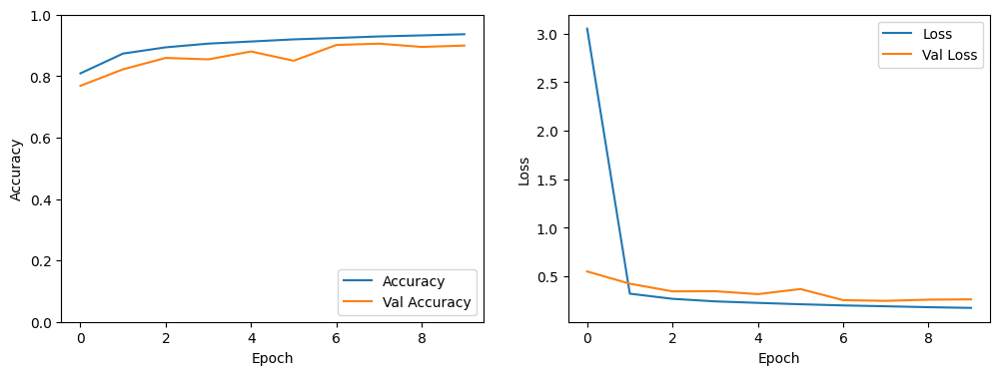

In [9]:
# Plotting training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

In [10]:
# Print the class indices
print(train_dataset.class_indices)


{'fake': 0, 'real': 1}


In [5]:
# Function to load and preprocess the image
def load_and_preprocess_image(img_path):
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img_path, class_indices):
    img_array = load_and_preprocess_image(img_path)
    prediction = model.predict(img_array)
    classes = list(class_indices.keys())
    predicted_class = np.argmax(prediction, axis=1)
    return classes[predicted_class[0]]

# Assuming you have the trained model in memory and the class indices
# Example usage
img_path = '/kaggle/input/ioyuiy/105859_1_01vid-deepfake-disinfo-summit_wg_1080p - frame at 0m5s.jpg'
predicted_class = predict_image(model, img_path, train_dataset.class_indices)
print(f'The image is predicted to be: {predicted_class}')

# Create a model that outputs the activations of each layer
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

# Function to plot the activations
def plot_layer_activations(activations, layer_names, images_per_row=8):
    for layer_name, layer_activation in zip(layer_names, activations):
        n_features = layer_activation.shape[-1]  # Number of features in the feature map
        size = layer_activation.shape[1]  # Feature map size
        
        n_cols = n_features // images_per_row  # Tiles the activation channels in this matrix
        display_grid = np.zeros((size * n_cols, images_per_row * size))
        
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0, :, :, col * images_per_row + row]
                channel_image -= channel_image.mean()
                if channel_image.std() != 0:
                    channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
        
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

# Pass the image through the model and get the activations
img_array = load_and_preprocess_image(img_path)
activations = activation_model.predict(img_array)

layer_names = [layer.name for layer in model.layers]

# Plot the activations of each layer
plot_layer_activations(activations, layer_names)

NameError: name 'load_img' is not defined

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_layer_activations(activations, layer_names, images_per_row=8):
    for layer_name, layer_activation in zip(layer_names, activations):
        n_features = layer_activation.shape[-1]  # Number of features in the feature map
        size = layer_activation.shape[1]  # Feature map size
        
        n_cols = n_features // images_per_row  # Tiles the activation channels in this matrix
        display_grid = np.zeros((size * n_cols, images_per_row * size))
        
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0, :, :, col * images_per_row + row]
                channel_image -= channel_image.mean()
                if channel_image.std() != 0:
                    channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
        
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')


In [ ]:
# Predict the class of the image
predicted_class = predict_image(model, img_path, train_dataset.class_indices)
print(f'The image is predicted to be: {predicted_class}')

# Get the activations of the sample image
activations = activation_model.predict(img_array)

# Get the layer names
layer_names = [layer.name for layer in model.layers]

# Plot the activations
plot_layer_activations(activations, layer_names)


In [ ]:
import os

if os.path.exists('/kaggle/working/deepfake_detection_model1.h5'):
    print("A file with the same name already exists. Please choose a unique name or delete the existing file.")
else:
    # Save the model if the file doesn't exist
    model.save('/kaggle/working/deepfake_detection_models_creaded_by_M_Junaid.h5')


In [6]:
!pip install face_recognition

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.1/100.1 MB 16.1 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 85.3 MB/s eta 0:00:00:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for dlib: filename=dlib-19.24.4-cp310-cp310-linux_x86_64.whl size=3327215 sha256=ef15b7e91b69119c6f12d0a0d3a4ede922c2727ef906c81f1de9eb2f72190cfb
  Stored in directory: /root/.cache/pip/wheels/08/5e/55/a7db8d57920eb2c2aa41c36dc4c6d3cd12323865de191a7211
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566165 sha256=559670dab7a4a741d26620b3715180eff9ba70903567707ce8e6c27f25e08bb2
  Stored in directory: /root/.cache/pip/wheels/7a/eb/cf/e9eced74122b679557f597bb7c8e4c739cfcac526db1fd523d
Successfully built dlib face-recognition-models


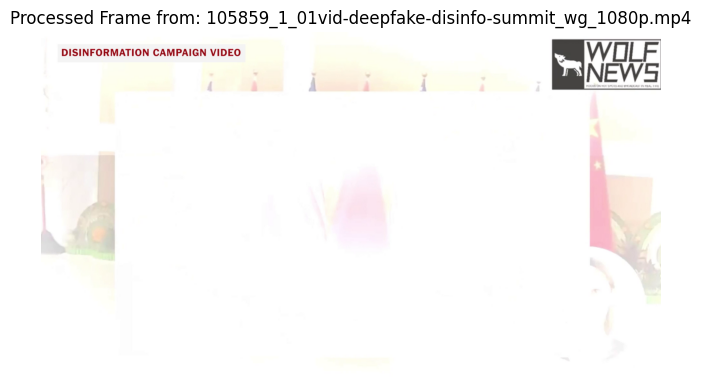

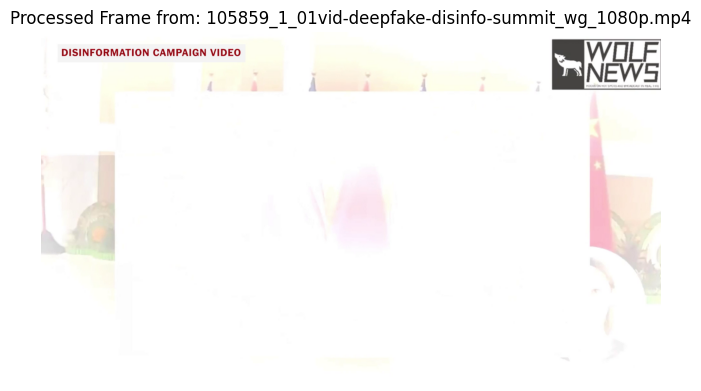

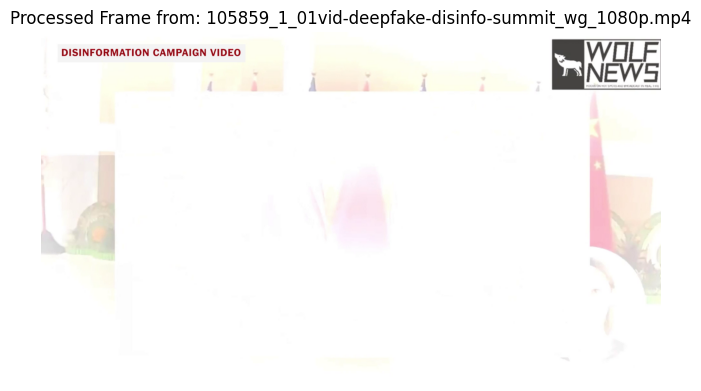

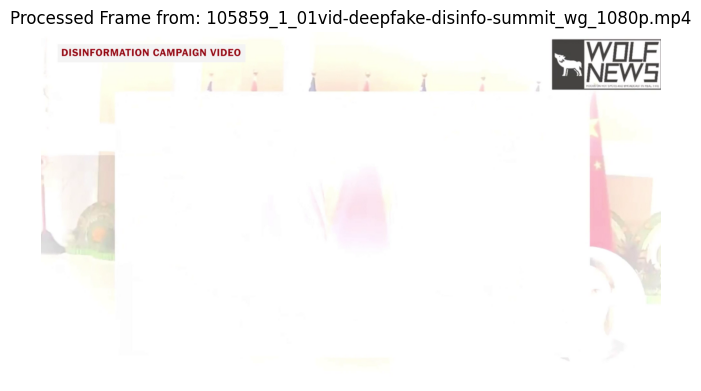

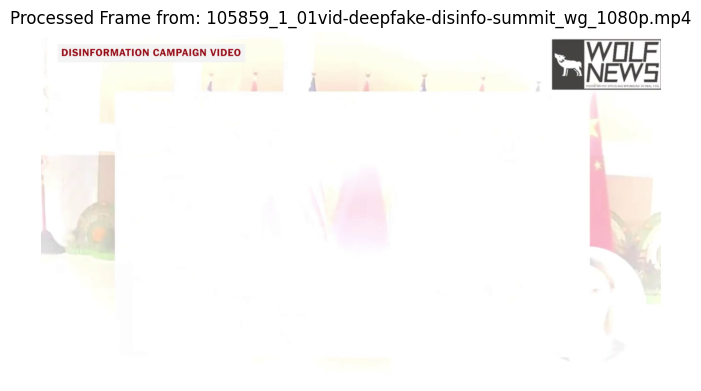

...

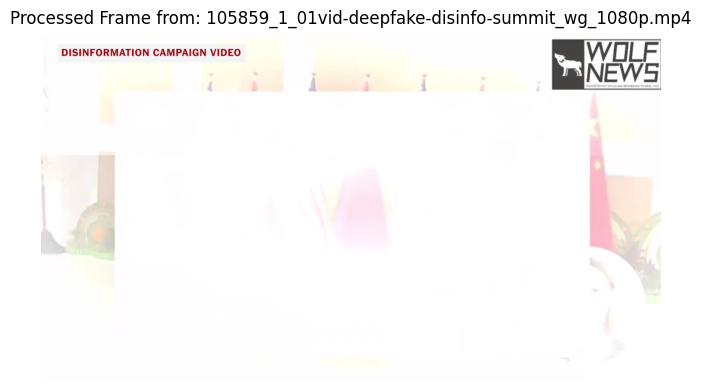

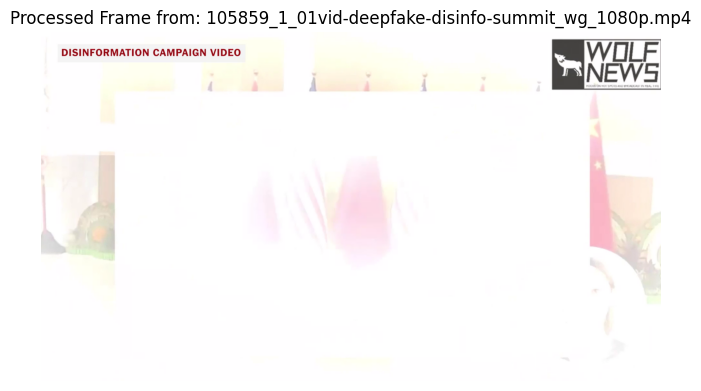

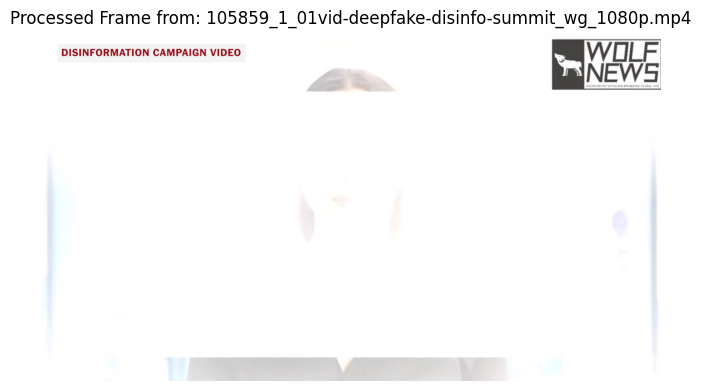

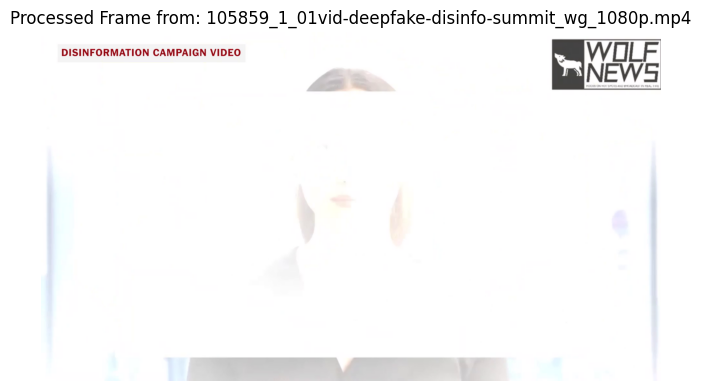

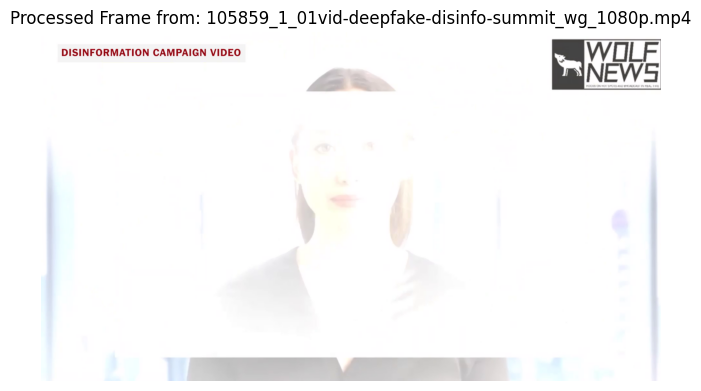

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


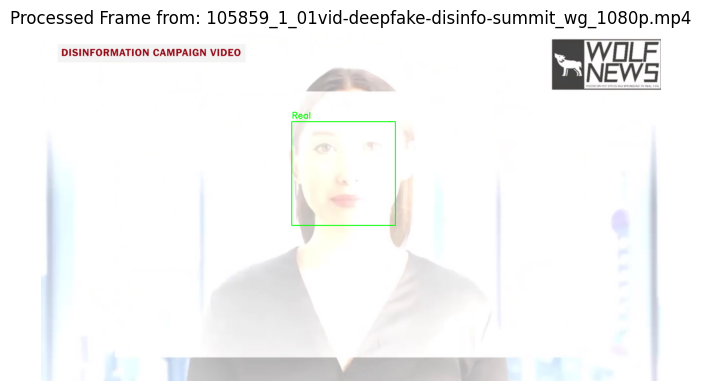

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


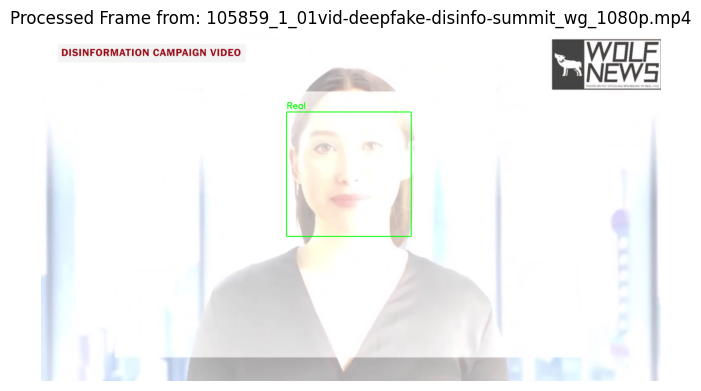

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


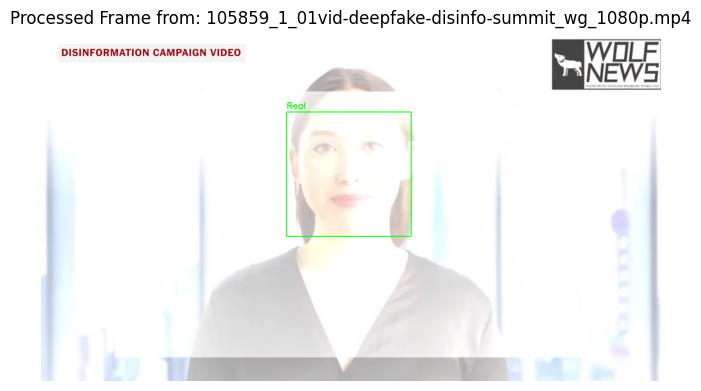

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


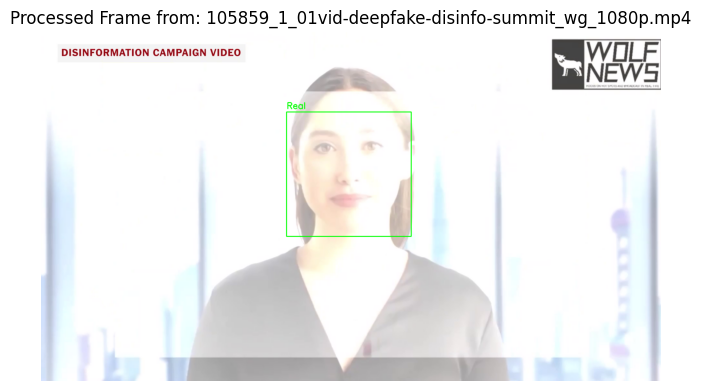

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


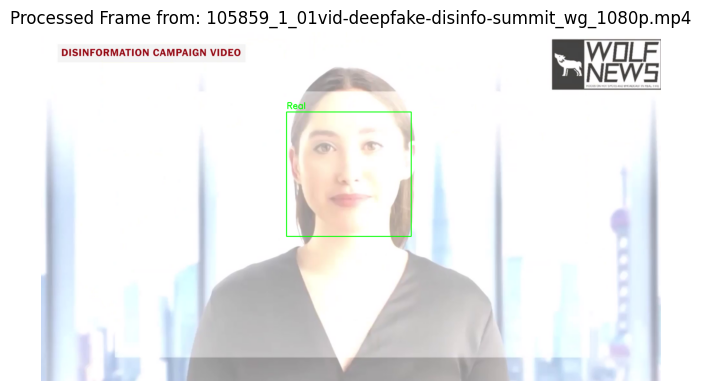

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


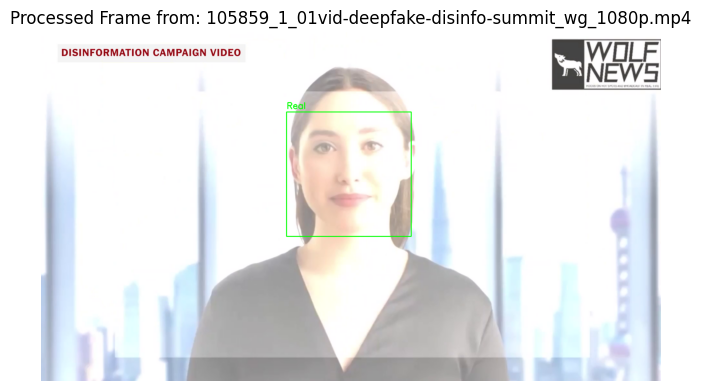

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


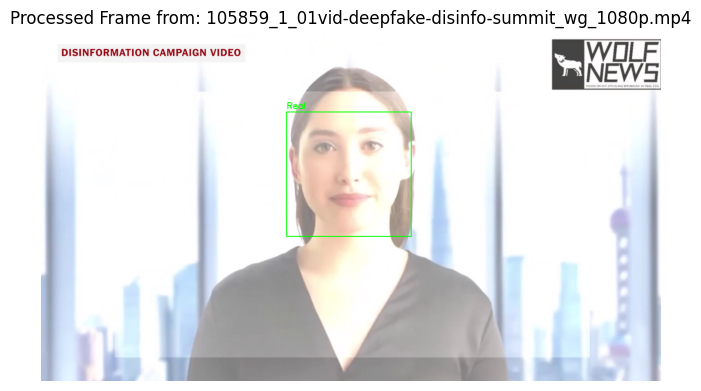

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


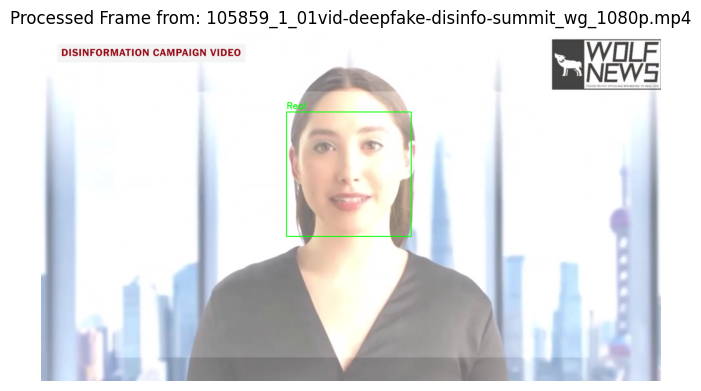

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


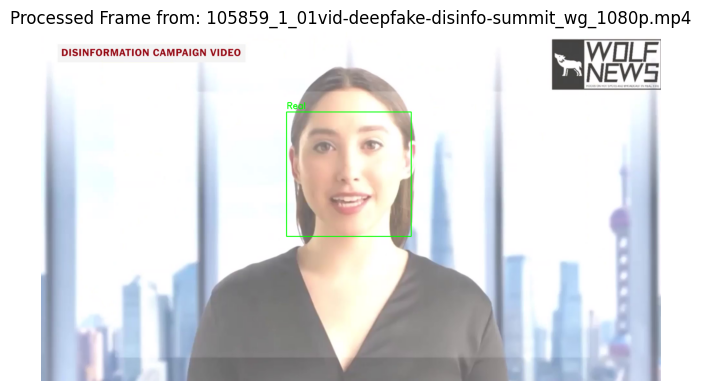

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


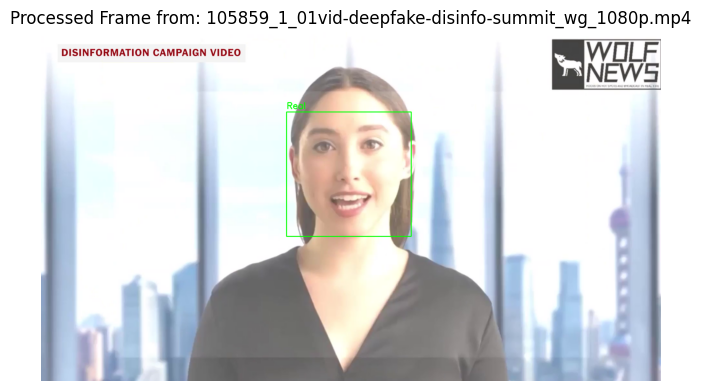

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


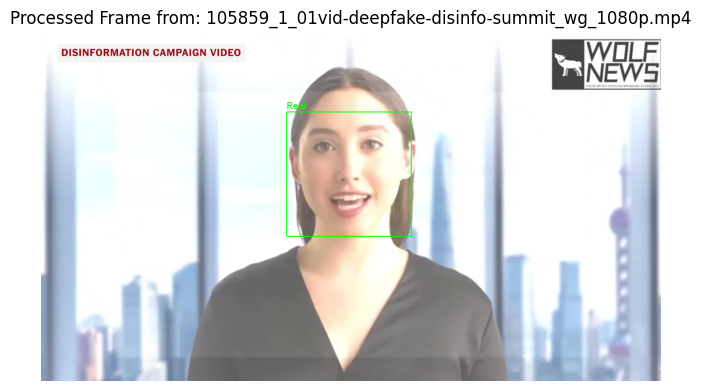

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


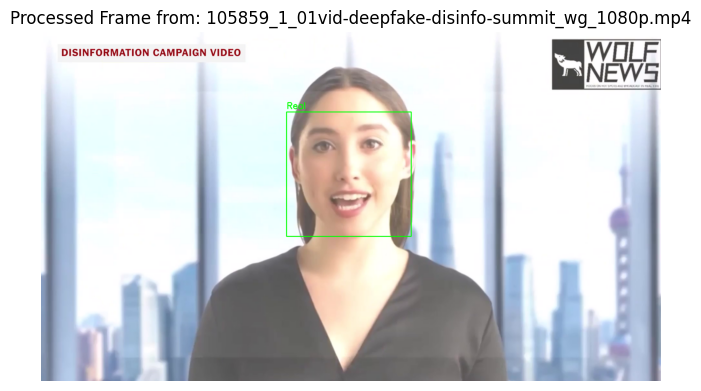

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


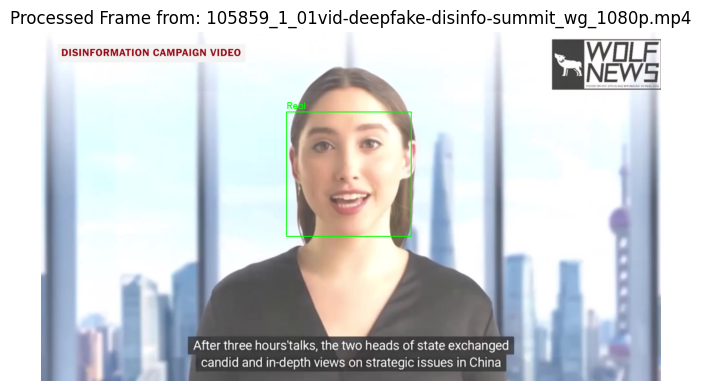

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


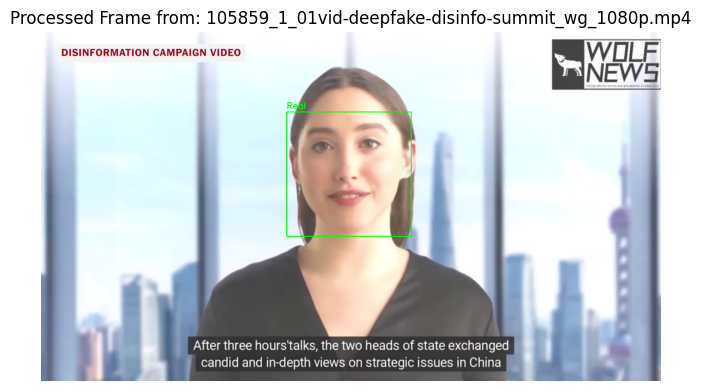

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


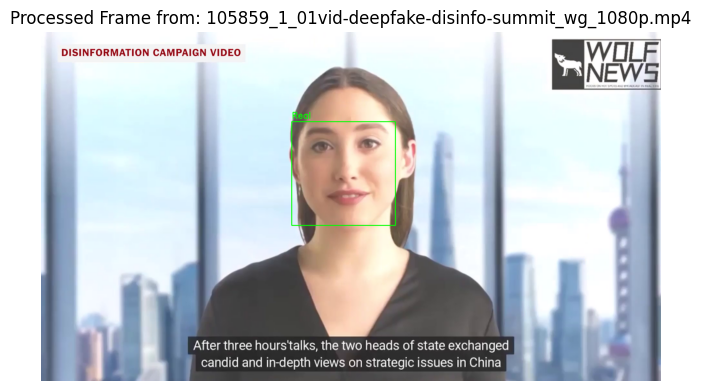

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


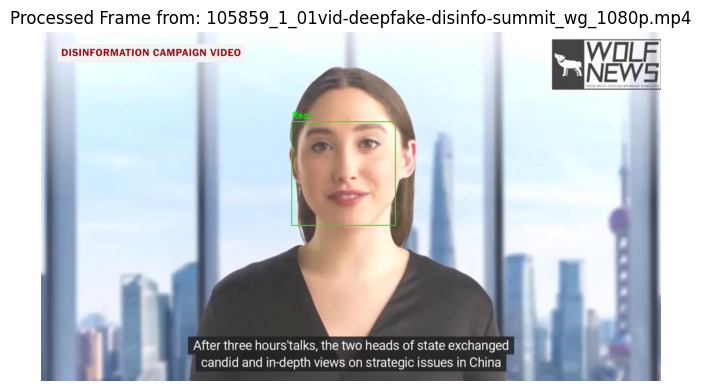

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


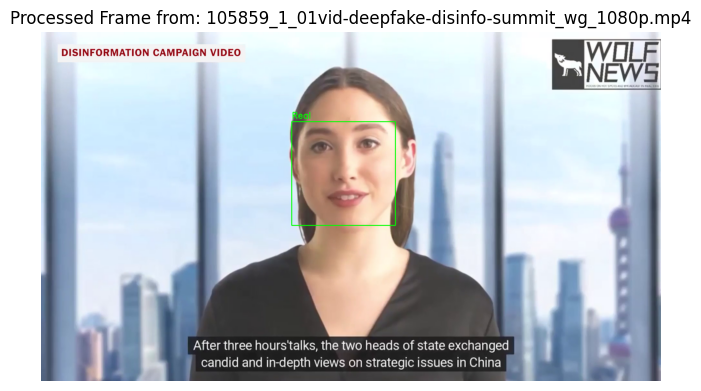

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


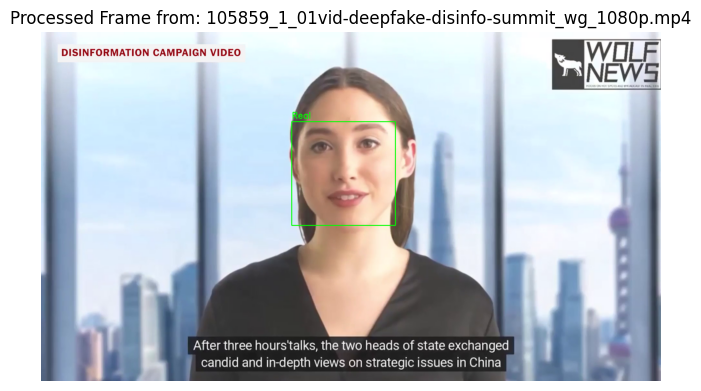

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


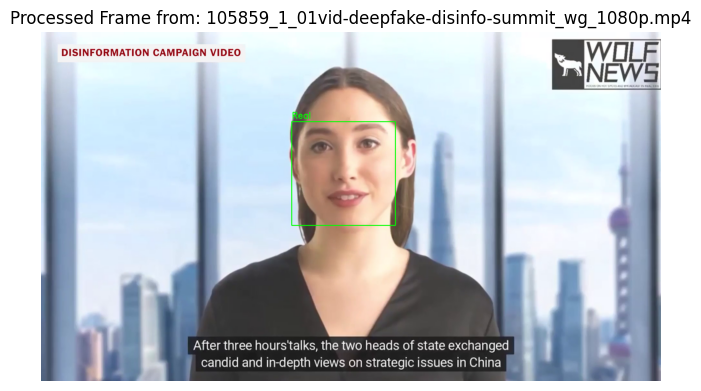

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


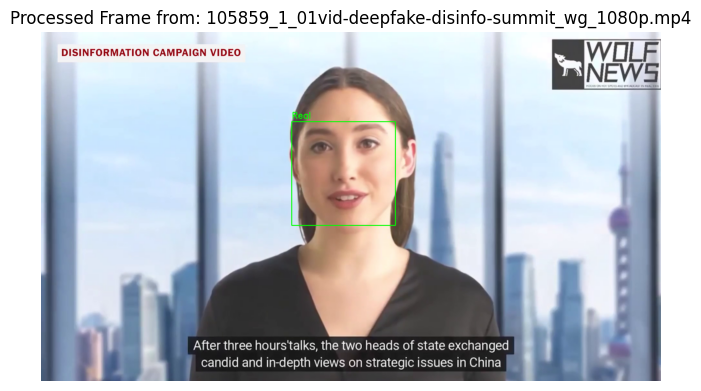

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


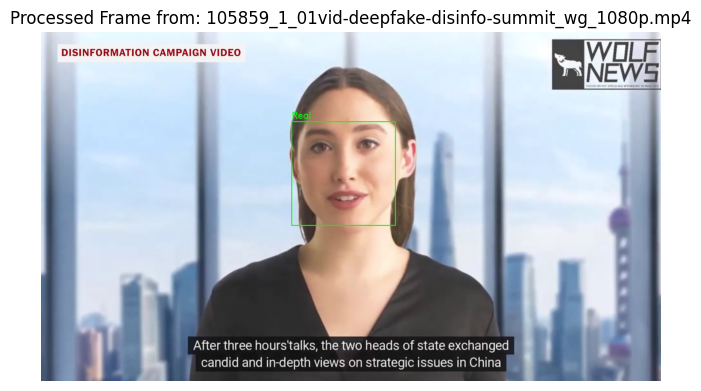

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


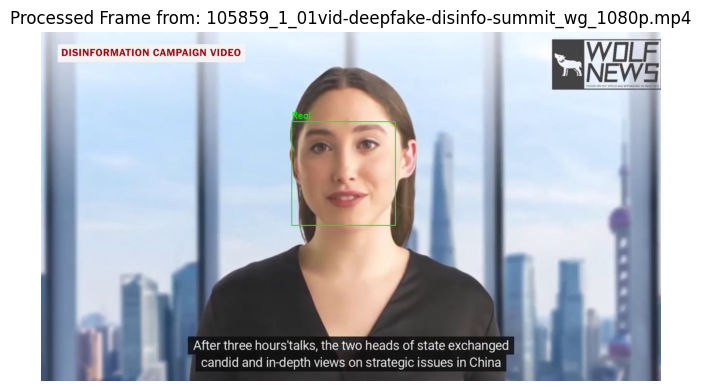

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


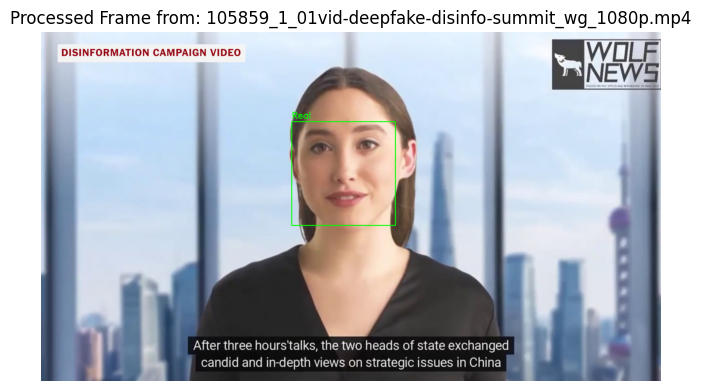

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


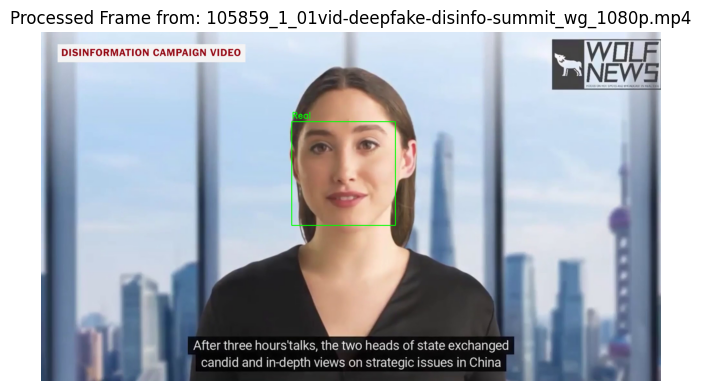

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


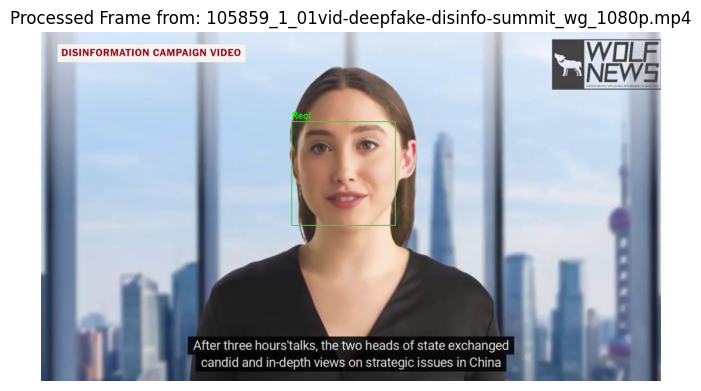

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


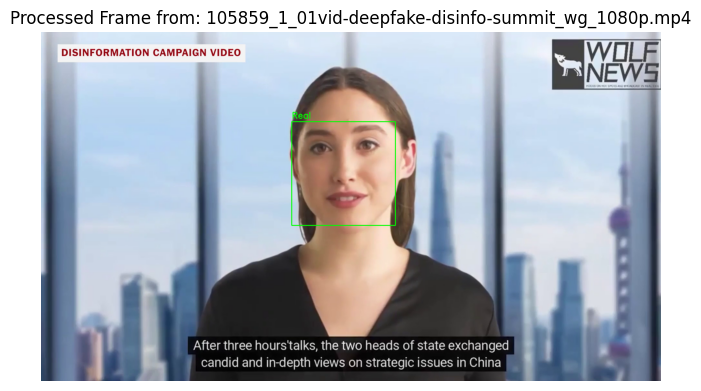

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


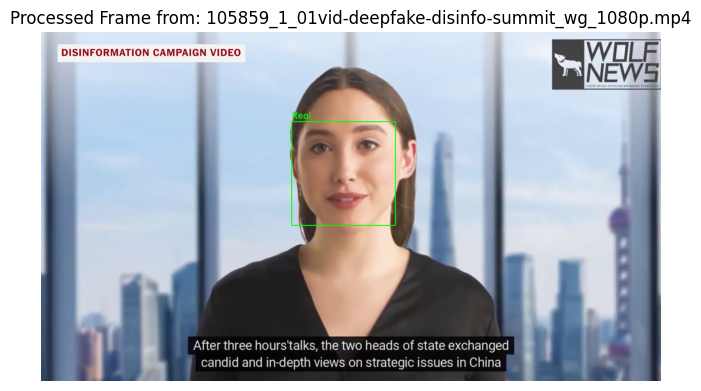

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


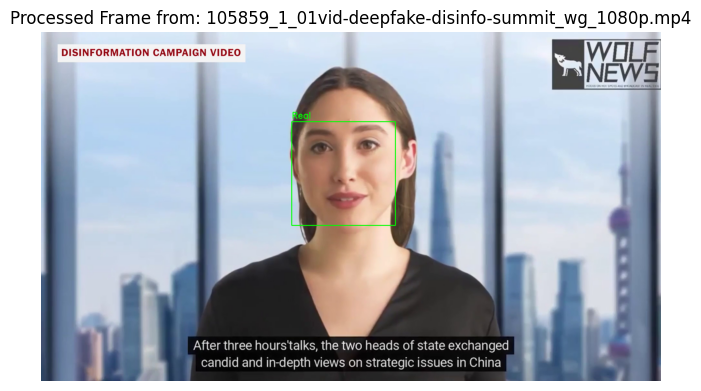

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


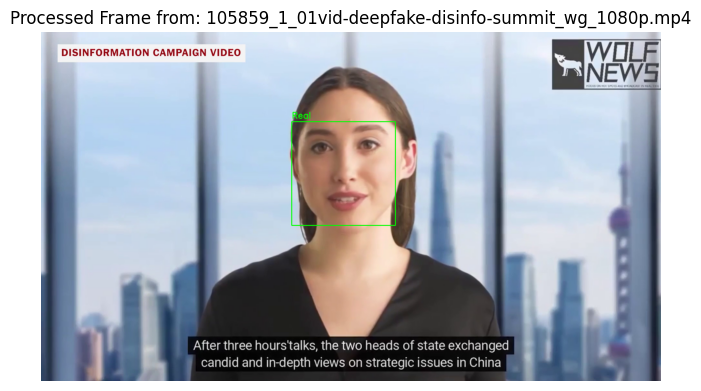

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


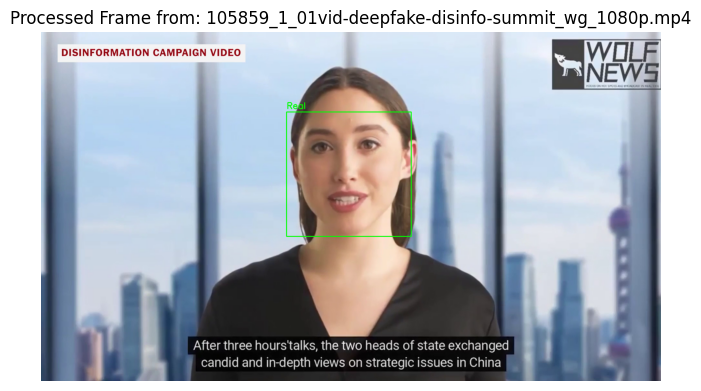

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


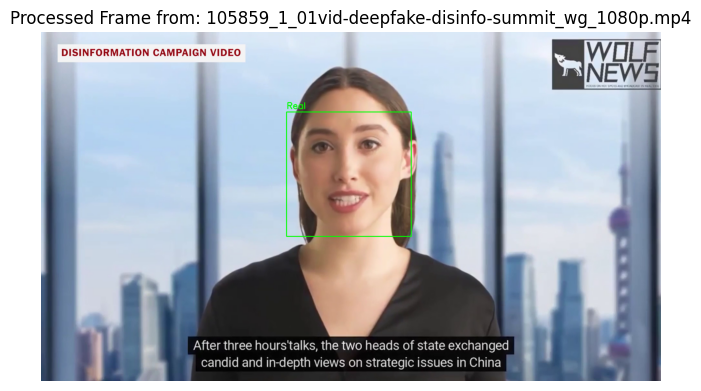

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


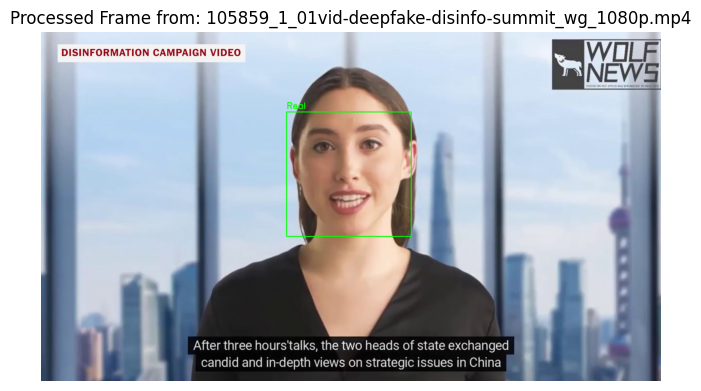

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


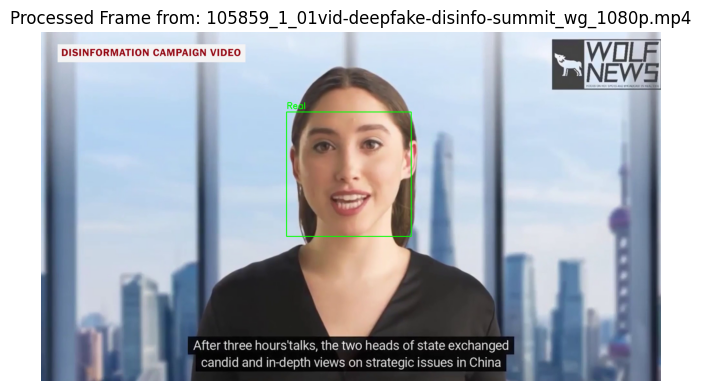

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


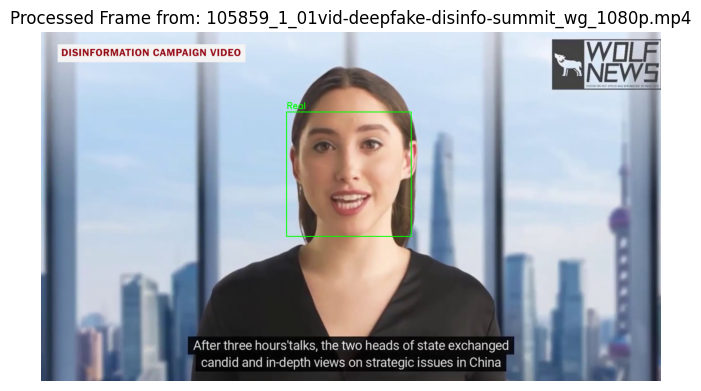

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


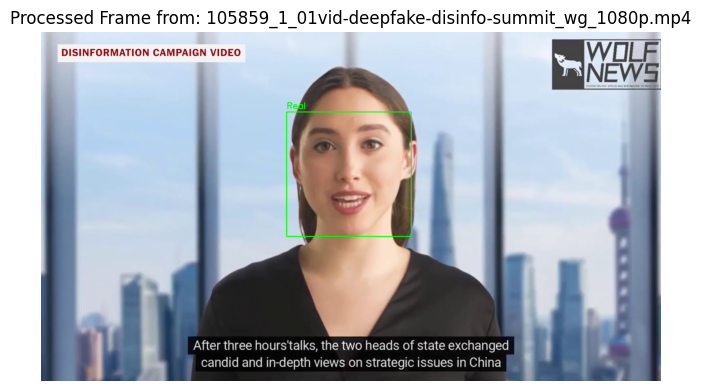

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


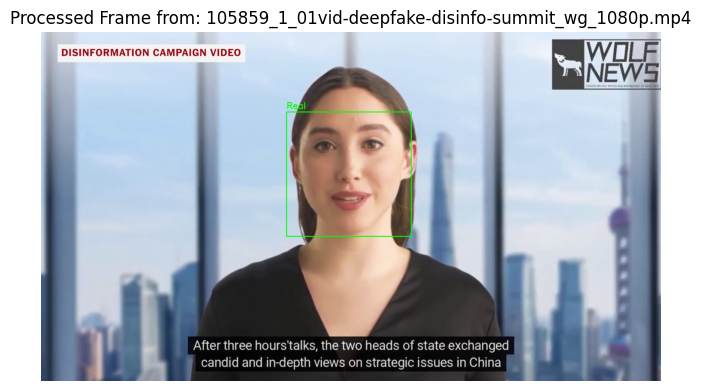

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


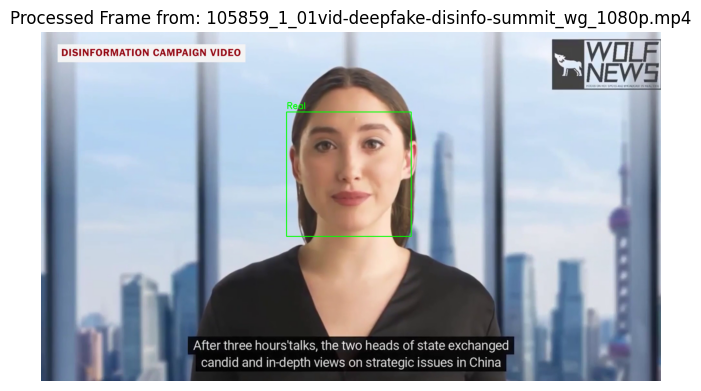

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


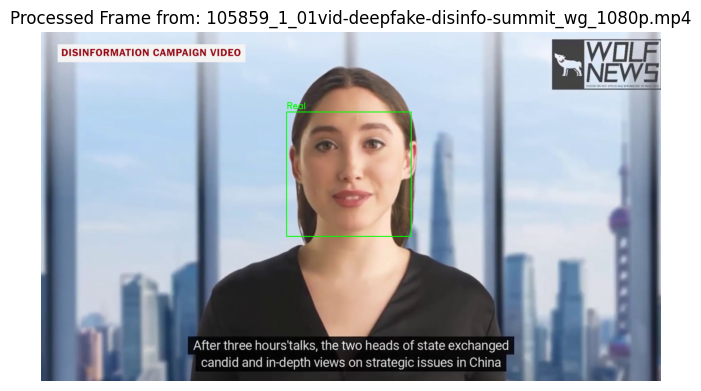

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


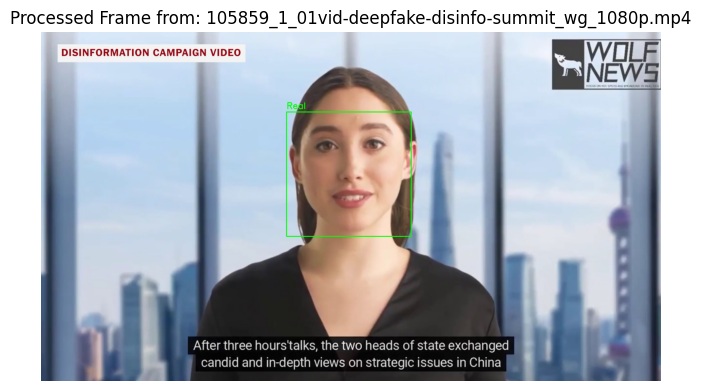

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


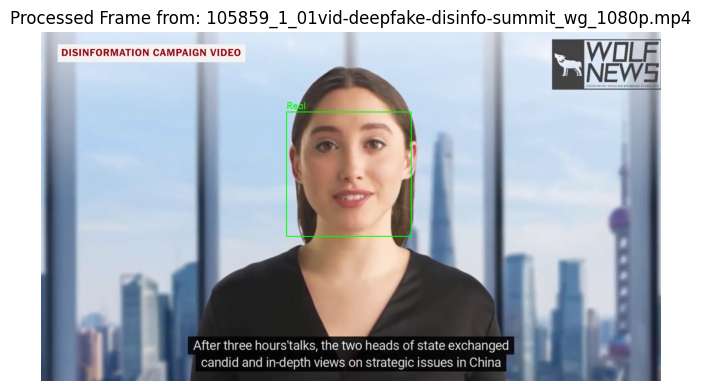

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


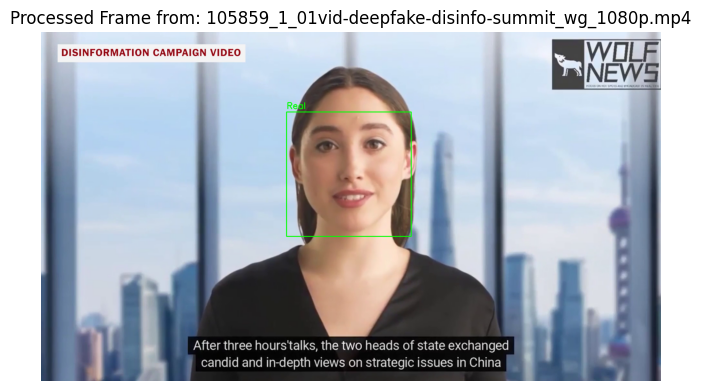

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


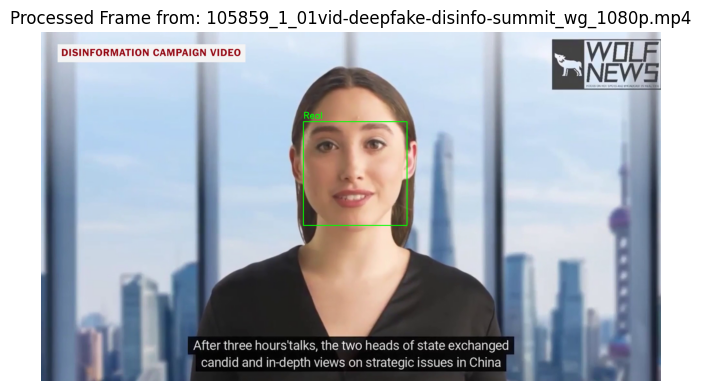

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


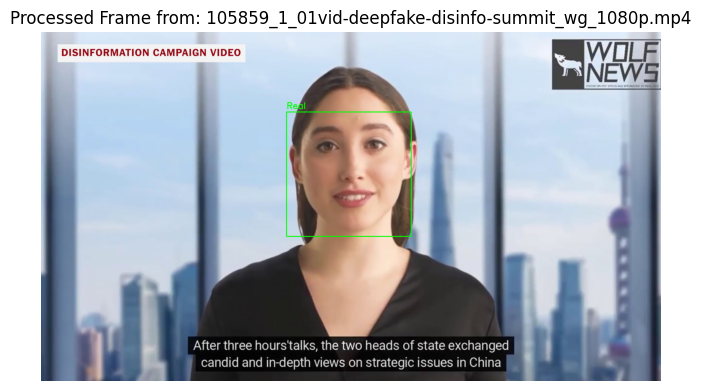

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


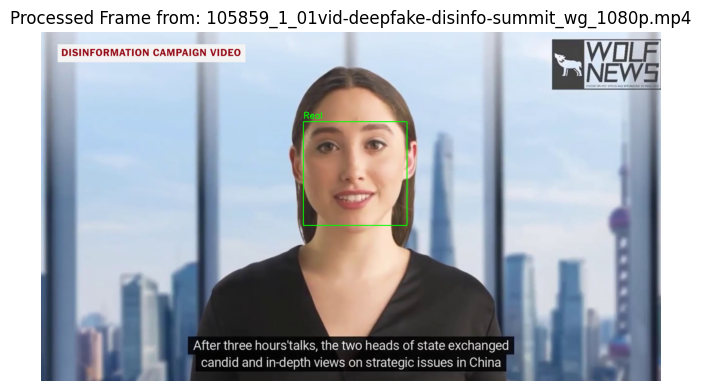

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


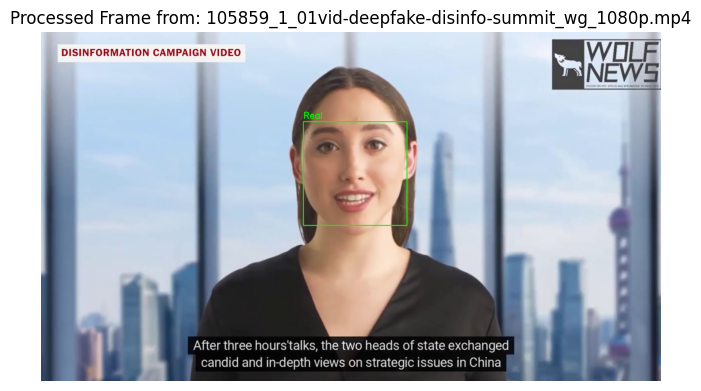

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


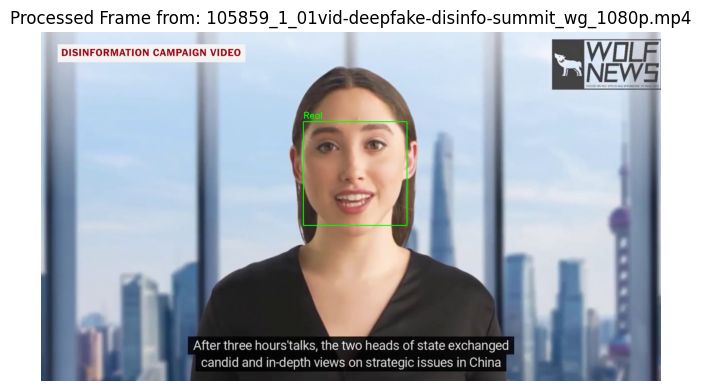

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


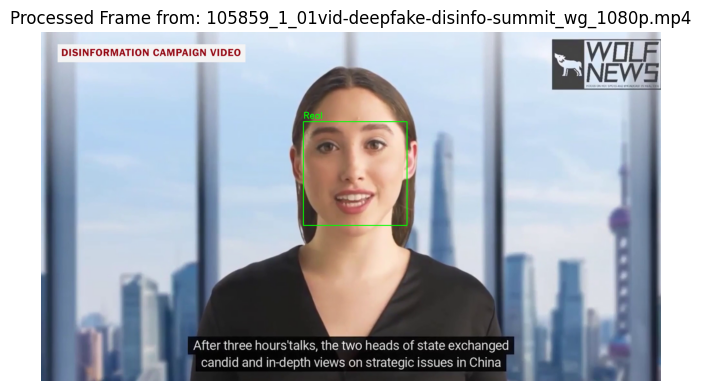

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


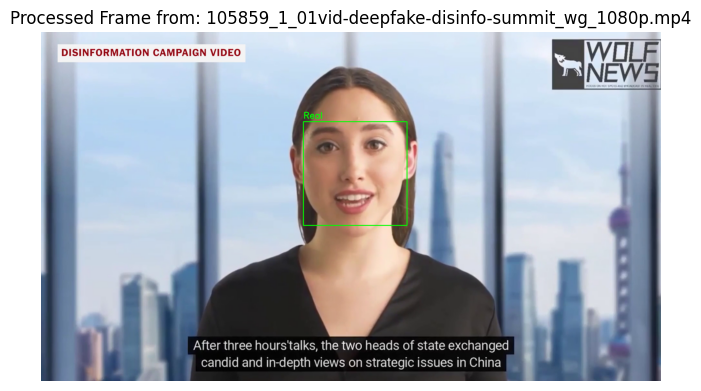

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


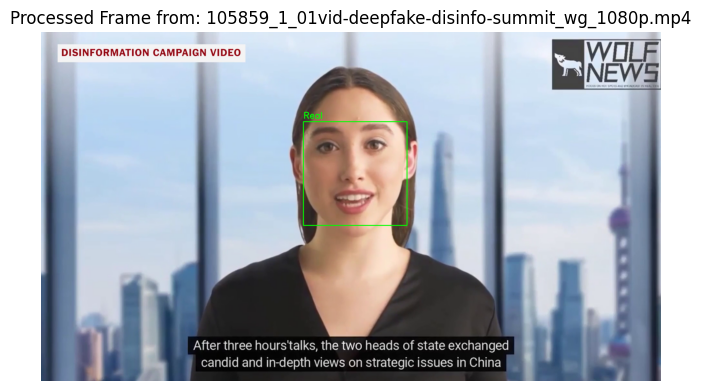

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


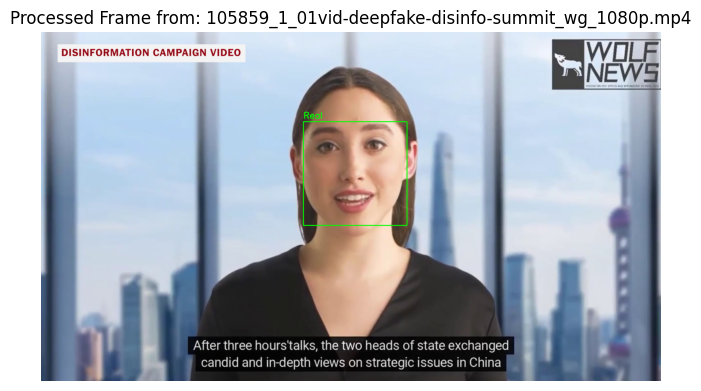

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


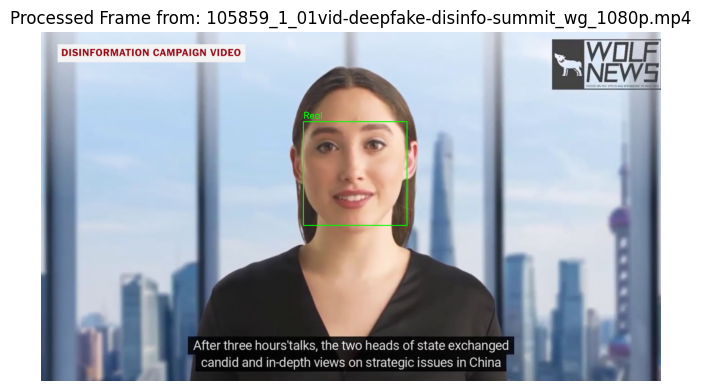

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


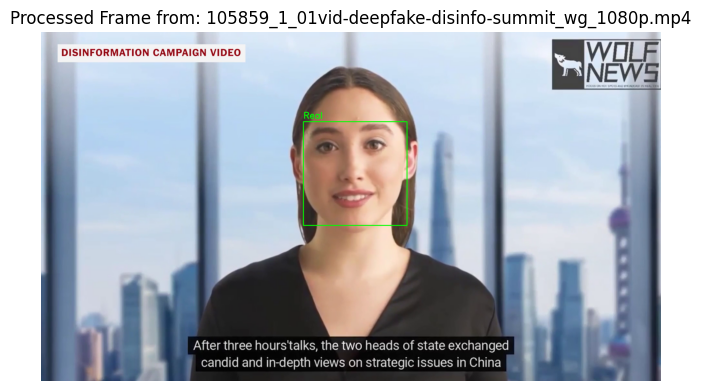

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


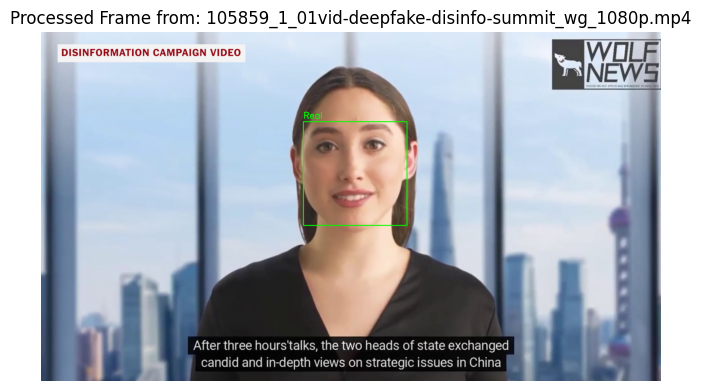

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


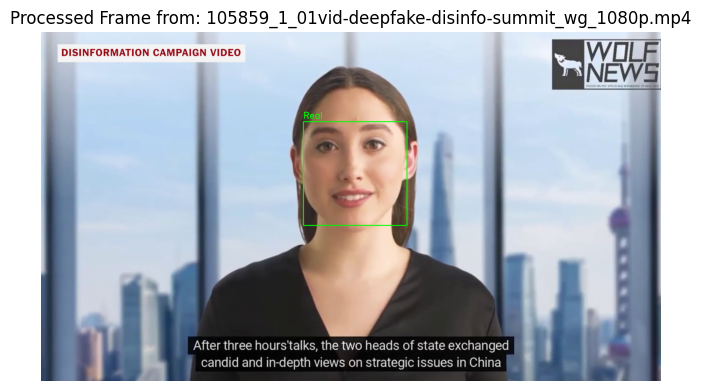

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


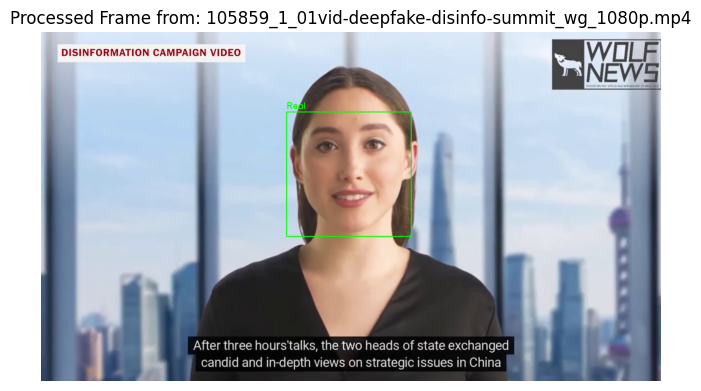

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


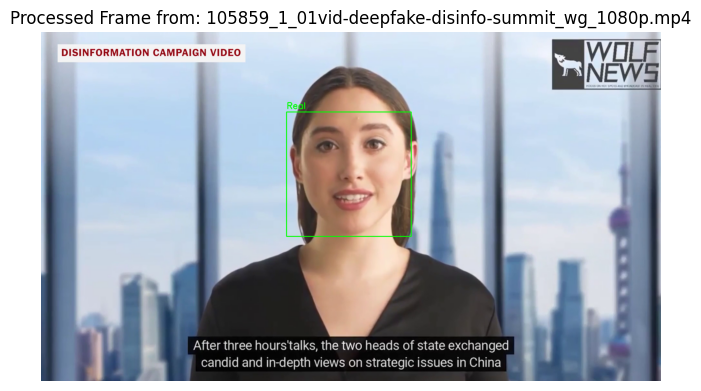

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


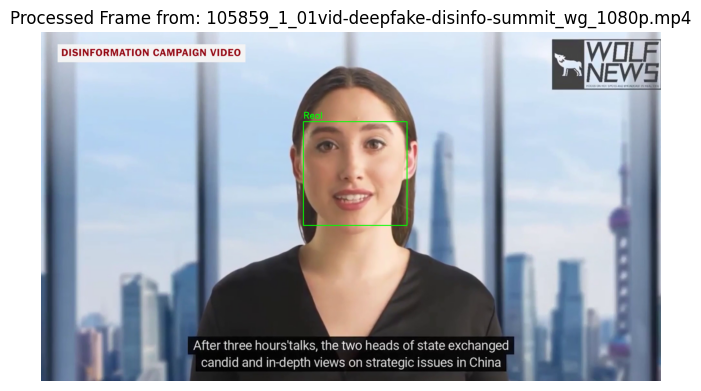

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


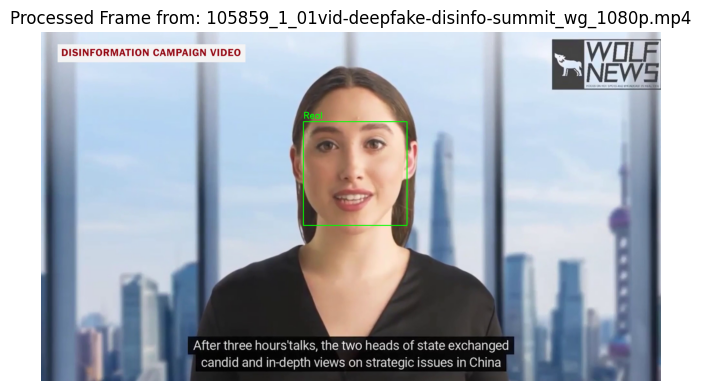

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


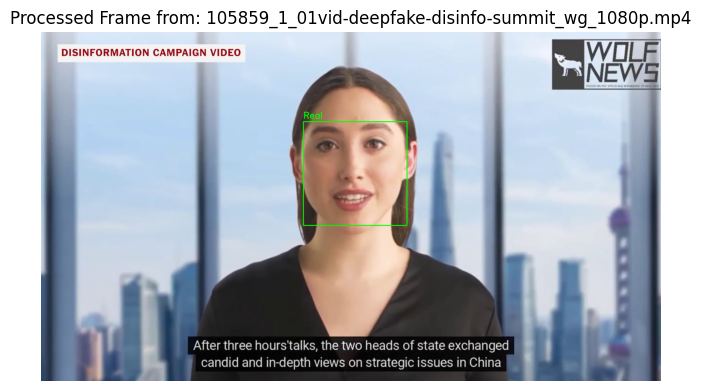

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


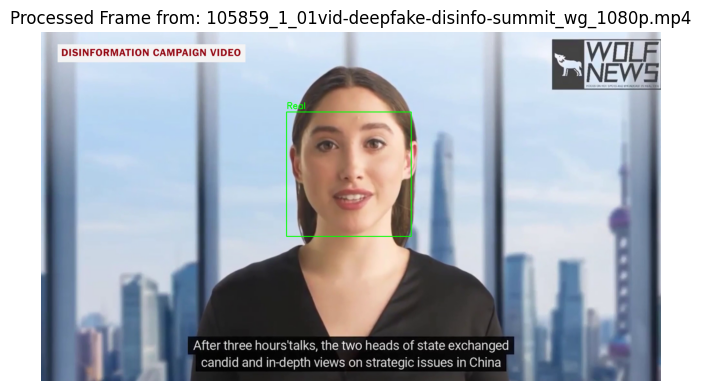

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


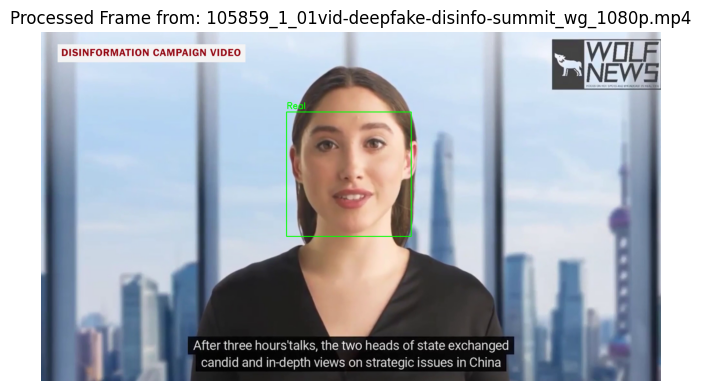

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


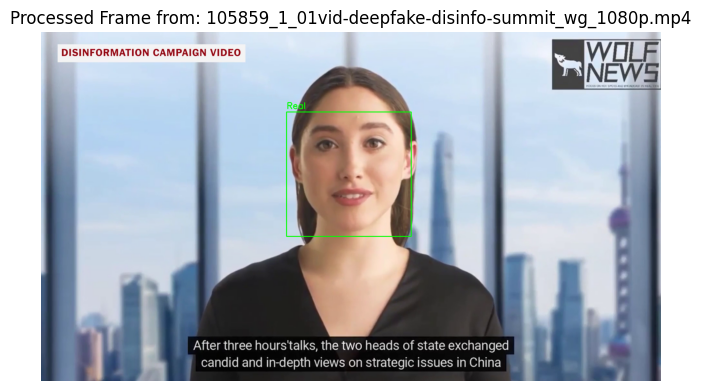

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


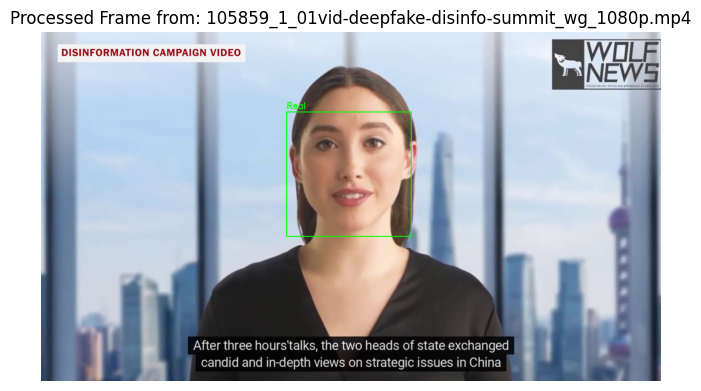

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


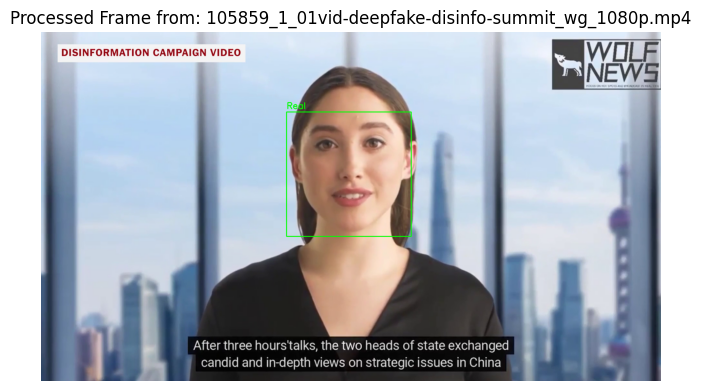

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


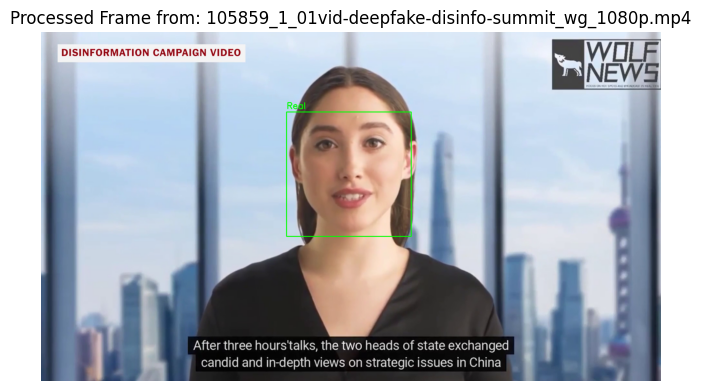

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


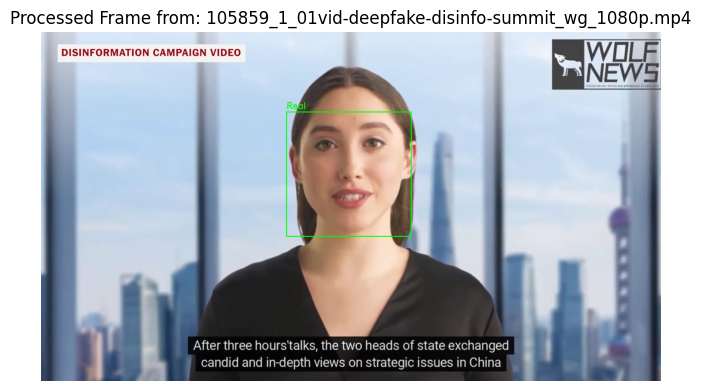

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


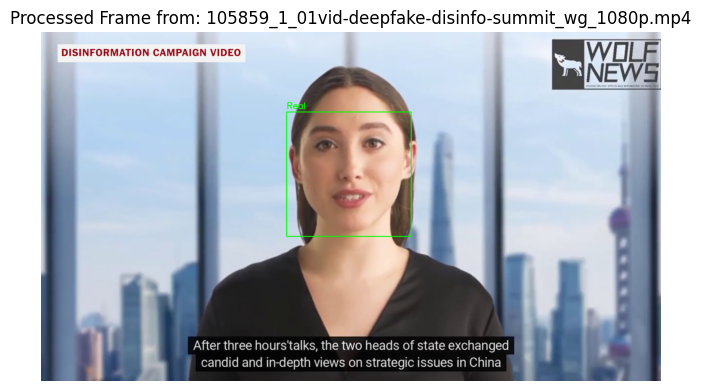

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


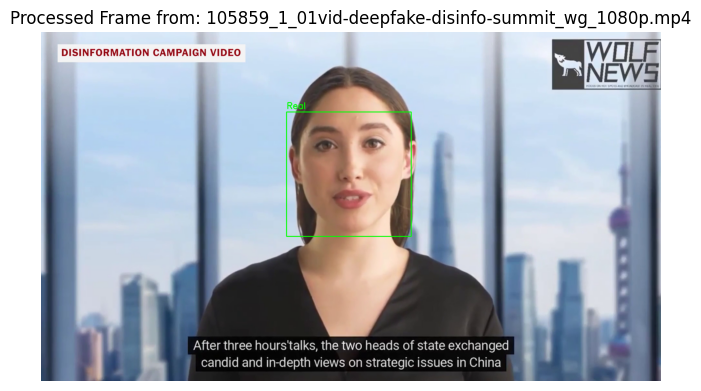

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


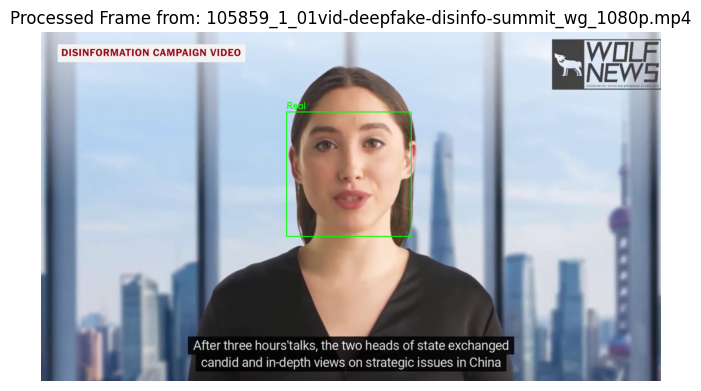

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


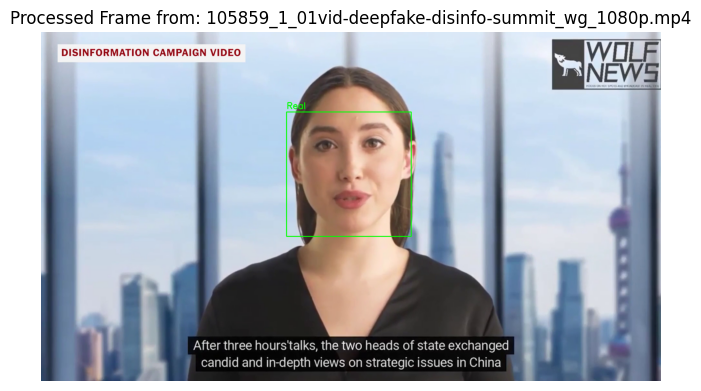

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


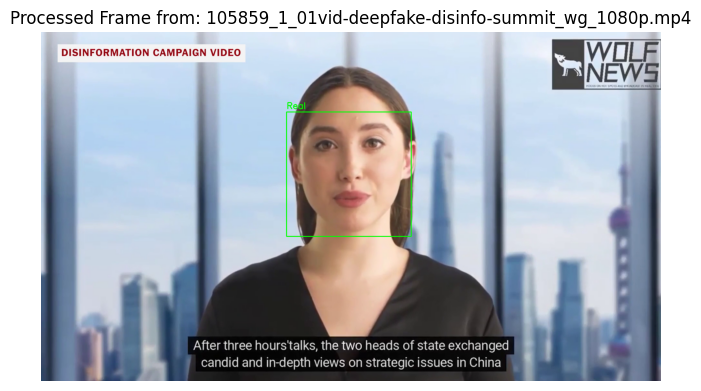

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


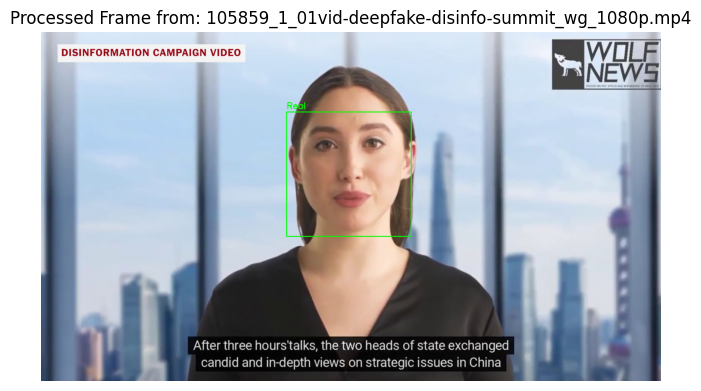

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


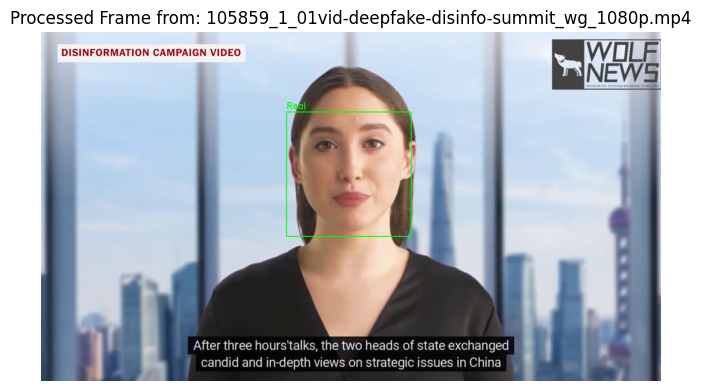

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


In [ ]:
import os
import cv2
import numpy as np
import face_recognition
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Function to load and preprocess the image
def load_and_preprocess_image(img):
    img_array = cv2.resize(img, (224, 224))
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img):
    img_array = load_and_preprocess_image(img)
    prediction = model.predict(img_array)
    if prediction[0][0] > 0.5:  # Assuming threshold of 0.5 for binary classification
        return "real"
    else:
        return "fake"

# Load the pre-trained model (replace 'your_model.h5' with your model's file name)
# model = load_model('/kaggle/input/your-model/your_model.h5')

# Directory containing the images (replace 'your-image-directory' with your directory name)
image_dir = '/kaggle/input/test11/'

# Iterate over each file in the directory
for file_name in os.listdir(image_dir):
    file_path = os.path.join(image_dir, file_name)
    
    # Check if the path is correct and the file is an image or video
    if not os.path.isfile(file_path):
        print(f"Error: {file_path} is not a valid file.")
        continue
    
    # Process images
    if file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
        frame = cv2.imread(file_path)
        
        if frame is None:
            print(f"Error: {file_path} could not be loaded.")
            continue
        
        # Detect faces in the image
        face_locations = face_recognition.face_locations(frame)
        
        # Process each detected face
        for (top, right, bottom, left) in face_locations:
            face = frame[top:bottom, left:right]
            prediction = predict_image(model, face)
            color = (0, 255, 0) if prediction == "real" else (0, 0, 255)
            label = "Real" if prediction == "real" else "Fake"
            cv2.rectangle(frame, (left, top), (right, bottom), color, 2)
            cv2.putText(frame, label, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
        
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Processed Image: {file_name}")
        plt.show()
    
    # Process videos
    elif file_name.lower().endswith(('.mp4', '.avi', '.mov')):
        cap = cv2.VideoCapture(file_path)
        
        if not cap.isOpened():
            print(f"Error: {file_path} could not be opened.")
            continue
        
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            
            # Detect faces in the frame
            face_locations = face_recognition.face_locations(frame)
            
            # Process each detected face
            for (top, right, bottom, left) in face_locations:
                face = frame[top:bottom, left:right]
                prediction = predict_image(model, face)
                color = (0, 255, 0) if prediction == "real" else (0, 0, 255)
                label = "Real" if prediction == "real" else "Fake"
                cv2.rectangle(frame, (left, top), (right, bottom), color, 2)
                cv2.putText(frame, label, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
            
            plt.figure(figsize=(8, 8))
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.title(f"Processed Frame from: {file_name}")
            plt.show()
        
        cap.release()
    else:
        print(f"Error: Unsupported file type: {file_path}")

# Close all OpenCV windows
cv2.destroyAllWindows()


In [ ]:
import os
import cv2
import numpy as np
import face_recognition
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Function to load and preprocess the image
def load_and_preprocess_image(img):
    img_array = cv2.resize(img, (224, 224))
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img):
    img_array = load_and_preprocess_image(img)
    prediction = model.predict(img_array)
    if prediction[0][0] > 0.5:  # Assuming threshold of 0.5 for binary classification
        return "real"
    else:
        return "fake"

# Load the pre-trained model (adjust the path as necessary)
# model_path = '/kaggle/working/deepfake_detection_model.h5'
# if not os.path.exists(model_path):
#     raise FileNotFoundError(f"Model file not found: {model_path}")
# model = load_model(model_path)

# Directory containing the images
image_dir = '/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/test/fake'

# Iterate over each file in the directory
for file_name in os.listdir(image_dir):
    file_path = os.path.join(image_dir, file_name)
    
    # Check if the path is correct and the file is an image
    if not os.path.isfile(file_path):
        print(f"Error: {file_path} is not a valid file.")
        continue
    
    if file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
        frame = cv2.imread(file_path)
        
        if frame is None:
            print(f"Error: {file_path} could not be loaded.")
            continue
        
        # Detect faces in the image
        face_locations = face_recognition.face_locations(frame)
        
        # Process each detected face
        for (top, right, bottom, left) in face_locations:
            face = frame[top:bottom, left:right]
            prediction = predict_image(model, face)
            color = (0, 255, 0) if prediction == "real" else (0, 0, 255)
            label = "Real" if prediction == "real" else "Fake"
            cv2.rectangle(frame, (left, top), (right, bottom), color, 2)
            cv2.putText(frame, label, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
        
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Processed Image: {file_name}")
        plt.show()
    else:
        print(f"Error: Unsupported file type: {file_path}")

# Close all OpenCV windows
cv2.destroyAllWindows()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


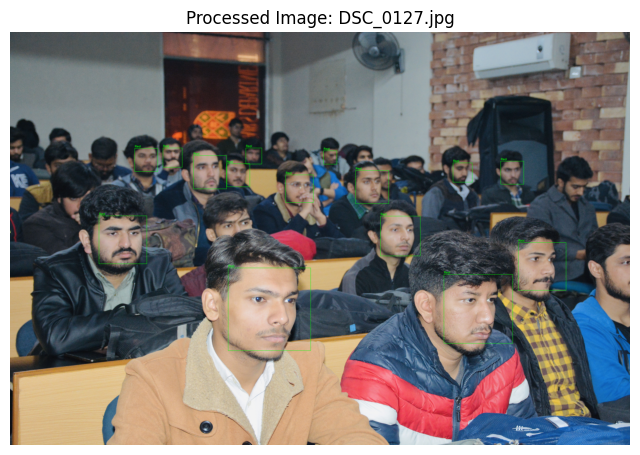

error: OpenCV(4.9.0) /io/opencv/modules/highgui/src/window.cpp:1266: error: (-2:Unspecified error) The function is not implemented. Rebuild the library with Windows, GTK+ 2.x or Cocoa support. If you are on Ubuntu or Debian, install libgtk2.0-dev and pkg-config, then re-run cmake or configure script in function 'cvDestroyAllWindows'


In [11]:
import os
import cv2
import numpy as np
import face_recognition
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Function to load and preprocess the image
def load_and_preprocess_image(img):
    img_array = cv2.resize(img, (224, 224))
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img):
    img_array = load_and_preprocess_image(img)
    prediction = model.predict(img_array)
    if prediction[0][0] > 0.5:  # Assuming threshold of 0.5 for binary classification
        return "real"
    else:
        return "fake"

# Load the pre-trained model (adjust the path as necessary)
# model_path = '/kaggle/working/deepfake_detection_model.h5'
# if not os.path.exists(model_path):
#     raise FileNotFoundError(f"Model file not found: {model_path}")
# model = load_model(model_path)

# Directory containing the images
image_dir = '/kaggle/input/djohkj'

# Iterate over each file in the directory
for file_name in os.listdir(image_dir):
    file_path = os.path.join(image_dir, file_name)
    
    # Check if the path is correct and the file is an image
    if not os.path.isfile(file_path):
        print(f"Error: {file_path} is not a valid file.")
        continue
    
    if file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
        frame = cv2.imread(file_path)
        
        if frame is None:
            print(f"Error: {file_path} could not be loaded.")
            continue
        
        # Detect faces in the image
        face_locations = face_recognition.face_locations(frame)
        
        # Process each detected face
        for (top, right, bottom, left) in face_locations:
            face = frame[top:bottom, left:right]
            prediction = predict_image(model, face)
            color = (0, 255, 0) if prediction == "real" else (0, 0, 255)
            label = "Real" if prediction == "real" else "Fake"
            cv2.rectangle(frame, (left, top), (right, bottom), color, 2)
            cv2.putText(frame, label, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
        
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Processed Image: {file_name}")
        plt.show()
    else:
        print(f"Error: Unsupported file type: {file_path}")

# Close all OpenCV windows
cv2.destroyAllWindows()


In [28]:
import os
import cv2
import numpy as np
import face_recognition
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Function to load and preprocess the image
def load_and_preprocess_image(img):
    img_array = cv2.resize(img, (224, 224))
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img):
    img_array = load_and_preprocess_image(img)
    prediction = model.predict(img_array)
    if prediction[0][0] > 0.5:  # Assuming threshold of 0.5 for binary classification
        return "real"
    else:
        return "fake"

# Load the pre-trained model (adjust the path as necessary)
# model_path = '/kaggle/working/deepfake_detection_model.h5'
# if not os.path.exists(model_path):
#     raise FileNotFoundError(f"Model file not found: {model_path}")
# model = load_model(model_path)

# Directory containing the images
image_dir = '/kaggle/input/testingimgexrtdf'

# Iterate over each file in the directory
for file_name in os.listdir(image_dir):
    file_path = os.path.join(image_dir, file_name)
    
    # Check if the path is correct and the file is an image
    if not os.path.isfile(file_path):
        print(f"Error: {file_path} is not a valid file.")
        continue
    
    if file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
        frame = cv2.imread(file_path)
        
        if frame is None:
            print(f"Error: {file_path} could not be loaded.")
            continue
        
        # Detect faces in the image
        face_locations = face_recognition.face_locations(frame)
        
        # Process each detected face
        for (top, right, bottom, left) in face_locations:
            face = frame[top:bottom, left:right]
            prediction = predict_image(model, face)
            color = (0, 255, 0) if prediction == "real" else (0, 0, 255)
            label = "Real" if prediction == "real" else "Fake"
            cv2.rectangle(frame, (left, top), (right, bottom), color, 2)
            cv2.putText(frame, label, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
        
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Processed Image: {file_name}")
        plt.show()
    else:
        print(f"Error: Unsupported file type: {file_path}")

# Close all OpenCV windows
cv2.destroyAllWindows()


AttributeError: 'str' object has no attribute 'predict'

In [ ]:
# Save the entire model in TensorFlow SavedModel format
model.save('/kaggle/working/1')


In [ ]:
# Save the entire model in the native Keras format
# model.save('/kaggle/working/')

# Alternatively, save in the TensorFlow SavedModel format
model.save('/kaggle/working/', save_format='tf')


In [ ]:
import os
import cv2
import numpy as np
import face_recognition
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Function to load and preprocess the image
def load_and_preprocess_image(img):
    img_array = cv2.resize(img, (224, 224))
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Rescale the image array
    return img_array

# Function to predict if the image is real or fake
def predict_image(model, img):
    img_array = load_and_preprocess_image(img)
    prediction = model.predict(img_array)
    if prediction[0][0] > 0.5:  # Assuming threshold of 0.5 for binary classification
        return "real"
    else:
        return "fake"

# Load the pre-trained model (replace 'deepfake_detection_model.h5' with your model's file name)
model_path = 'deepfake_detection_model.h5'  # Ensure the path is correct
if not os.path.exists(model_path):
    raise FileNotFoundError(f"Model file not found: {model_path}")
model = load_model(model_path)

# Path to the image (replace with your image path)
image_path = '/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/test/fake/008BYSE725.jpg'

if not os.path.isfile(image_path):
    print(f"Error: {image_path} is not a valid file.")
else:
    try:
        # Process the image
        frame = cv2.imread(image_path)
        
        if frame is None:
            print(f"Error: {image_path} could not be loaded.")
        else:
            # Detect faces in the image
            face_locations = face_recognition.face_locations(frame)
            
            # Process each detected face
            for (top, right, bottom, left) in face_locations:
                face = frame[top:bottom, left:right]
                prediction = predict_image(model, face)
                color = (0, 255, 0) if prediction == "real" else (0, 0, 255)
                label = "Real" if prediction == "real" else "Fake"
                cv2.rectangle(frame, (left, top), (right, bottom), color, 2)
                cv2.putText(frame, label, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
            
            plt.figure(figsize=(8, 8))
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.title(f"Processed Image: {os.path.basename(image_path)}")
            plt.show()
    except Exception as e:
        print(f"An error occurred while processing {image_path}: {e}")

# Close all OpenCV windows
cv2.destroyAllWindows()


In [ ]:
# Assuming you have already trained your model
# Save the model to a file with a unique name
model.save('/kaggle/working/deepfake_detection_model_unique.h5')


In [ ]:
import os

model_path = '/kaggle/working/deepfake_detection_model_unique.h5'

# Check if the file already exists, and if so, delete it
if os.path.exists(model_path):
    os.remove(model_path)

# Save the model to a file with a unique name
model.save(model_path)



<h1>import libraries and ther explanation with a example</h1>


****Sure! Let's break down the code and explain the different parts and what they are used for.

### 1. Importing Libraries
```python
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2
```
- `numpy`: A library for numerical computations, particularly with arrays.
- `matplotlib.pyplot`: A library for plotting graphs and visualizing data.
- `tensorflow`: An open-source library for machine learning and deep learning.
- `keras.layers`: A submodule in Keras, part of TensorFlow, that provides various layers for building neural networks.
- `keras.callbacks`: A submodule in Keras that provides utilities to optimize training, such as early stopping and learning rate reduction.
- `tensorflow.keras.applications`: Contains pre-trained models, such as VGG16.
- `tensorflow.keras.preprocessing.image`: Contains utilities for processing images, including data augmentation.
- `tensorflow.keras.regularizers`: Provides regularization techniques to prevent overfitting.

### 2. Layers
- `Dense`: A fully connected neural network layer.
- `Dropout`: A regularization layer that randomly sets a fraction of input units to 0 during training to prevent overfitting.
- `Conv2D`: A convolutional layer used primarily in image processing.
- `MaxPooling2D`: A pooling layer that reduces the spatial dimensions (height, width) of the input volume.
- `Flatten`: Converts a multi-dimensional input into a single dimension.
- `BatchNormalization`: A layer that normalizes the activations of the previous layer at each batch, improving stability and performance.

### 3. Callbacks
- `EarlyStopping`: Stops training when a monitored metric has stopped improving.
- `ReduceLROnPlateau`: Reduces the learning rate when a metric has stopped improving.

### 4. Pre-trained Models
- `VGG16`: A pre-trained convolutional neural network model that is 16 layers deep. It is often used for image classification tasks.

### 5. Image Data Generators
- `ImageDataGenerator`: A utility for augmenting images in real-time during training. It can apply transformations such as rotations, scaling, and flipping.

### 6. Regularizers
- `l2`: A regularization technique that adds a penalty to the loss function proportional to the square of the value of the weights. This helps to prevent overfitting by encouraging smaller weights.

### Example Usage

Here is an example of how these components might be used together:

```python
# Load the VGG16 model with pre-trained weights, excluding the top (fully connected) layers
vgg16 = VGG16(include_top=False, input_shape=(224, 224, 3))

# Freeze the layers of VGG16 so they are not trained
for layer in vgg16.layers:
    layer.trainable = False

# Create a new model with additional layers on top of VGG16
model = tf.keras.models.Sequential([
    vgg16,
    Flatten(),
    Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.5),
    Dense(128, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.5),
    Dense(10, activation='softmax')  # Assuming 10 classes for classification
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.001)

# Image data generators for training and validation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    'data/train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

validation_generator = test_datagen.flow_from_directory(
    'data/validation',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=100,
    epochs=50,
    validation_data=validation_generator,
    validation_steps=50,
    callbacks=[early_stopping, reduce_lr]
)
```

### Explanation
1. **Loading and Freezing VGG16**:
   - Load the pre-trained VGG16 model without its top layers.
   - Freeze its layers to prevent them from being trained.

2. **Building the Model**:
   - Add a `Flatten` layer to convert the 3D output of VGG16 to 1D.
   - Add two `Dense` layers with `Dropout` and `l2` regularization for classification.
   - The final `Dense` layer has 10 units (one for each class) with a softmax activation function for multi-class classification.

3. **Compiling the Model**:
   - Use the Adam optimizer and categorical cross-entropy loss for multi-class classification.

4. **Setting Callbacks**:
   - `EarlyStopping` to stop training if validation loss does not improve for 10 epochs.
   - `ReduceLROnPlateau` to reduce the learning rate if validation loss plateaus.

5. **Data Augmentation**:
   - `ImageDataGenerator` is used to augment the training images (rescaling, shear, zoom, horizontal flip).
   - Validation images are only rescaled.

6. **Training**:
   - Train the model using the training data generator and validate using the validation data generator.
   - Use the defined callbacks during training.

This setup allows for training a robust image classification model with data augmentation and regularization to prevent overfitting.****

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2

Setting the Random Seed:

In machine learning and deep learning, many operations involve randomness, such as weight initialization, shuffling of data, and augmentation. By setting a seed, you ensure that these operations produce the same results every time you run your code. This is crucial for reproducibility, which allows you and others to replicate your experiments and results.

In [ ]:
# Set seed for reproducibility
tf.random.set_seed(0)


load the data

In [ ]:
# Define the path to your main dataset directory
dataset_dir = "/kaggle/input/deepfake-detection-dataset-randomized/merged_dataset/train"

Data aragment

rescale: Normalizes the pixel values to the range [0, 1] by scaling them by 1/255.
validation_split: Splits the data into training and validation sets, with 30% of the data used for validation.
shear_range: Randomly shears the images.
zoom_range: Randomly zooms into the images.
horizontal_flip: Randomly flips images horizontally.
rotation_range: Randomly rotates images by up to 30 degrees.
width_shift_range: Randomly shifts the images horizontally by up to 30% of the width.
height_shift_range: Randomly shifts the images vertically by up to 30% of the height.



flow_from_directory: Generates batches of augmented data from the images stored in the directory.
dataset_dir: The path to the dataset directory.
target_size=(224, 224): Resizes all images to 224x224 pixels.
batch_size=32: Processes images in batches of 32.
class_mode='sparse': Returns class labels as integers. This is useful for sparse categorical cross-entropy loss, where classes are not one-hot encoded.
subset='training' and subset='validation': Specifies the subset of data to use based on the validation split.

In [ ]:
# Data Augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3,  # Use a 70-30 train-validation split
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    rotation_range=30,  # Increased rotation range
    width_shift_range=0.3,  # Increased width shift range
    height_shift_range=0.3  # Increased height shift range
)

val_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.3
)

train_dataset = train_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='training'
)

val_dataset = val_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    subset='validation'
)